<a href="https://colab.research.google.com/github/arpanbiswas52/Preisach/blob/main/PreisachModel(ForwardModel)_short.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Preisach Model

October, 2021

This notebook contains Preisach model and the evolution of loop, drawn from the evolution of hysterons state (switch on/off) over the Preisach plane along waveform (Voltage).

**Here we assume the Preisach density is known and calculate the signal to form the loop, given the density and the waveform**

- proposed by Sergei V. Kalinin

- Preisach Model and Workflow prepared by Arpan Biswas

- Data (FORC) provided by Yongtou 


In [1]:
!pip install pycroscopy #version 0.60.8

     |████████████████████████████████| 348 kB 4.3 MB/s 
     |████████████████████████████████| 51 kB 275 kB/s 
     |████████████████████████████████| 790 kB 42.3 MB/s 
     |████████████████████████████████| 87 kB 4.5 MB/s 
     |████████████████████████████████| 66 kB 5.1 MB/s 
     |████████████████████████████████| 374 kB 62.4 MB/s 
     |████████████████████████████████| 481 kB 49.5 MB/s 
     |████████████████████████████████| 793 kB 48.0 MB/s 
     |████████████████████████████████| 1.0 MB 25.6 MB/s 
     |████████████████████████████████| 132 kB 57.1 MB/s 
  Created wheel for numpy-groupies: filename=numpy_groupies-0.9.7-py3-none-any.whl size=21314 sha256=29eb65e6536ed90f2f35ffa2cecfff7fa67721bca158a4256c0c02a5d5e8a2af
  Stored in directory: /root/.cache/pip/wheels/11/05/e1/250ebec6656f2a0bc1141d5c185876dcd74e7e47740613c9d6
  Created wheel for cytoolz: filename=cytoolz-0.11.2-cp37-cp37m-linux_x86_64.whl size=1231113 sha256=3d38b4339a5456fae5efce3d43446ba5f35bf23202db38165d8c6

In [1]:
import matplotlib.pyplot as plt
import numpy as np

import h5py
import pyUSID as usid #version 0.0.10
from scipy.stats import norm
from scipy.stats import bernoulli

#Defined Functions

1. Hysteron state initialization over defined Preisach plane

2. Signal calculation, given V from waveform and known density function

3. Plotting the change of hysteron state over Preisach plane, given the state of waveform -- and the evolution of signal loop

##The density function is in two parts as follows:

$p(E1, E2) = w_{rev}*\phi_{rev}(E1, E2) + w_{ir}*\phi_{ir}(E1, E2)$ , where $w_{rev}, w_{ir}$ are the weighting factor over reversible, $\phi_{rev}$ and irreversible, $\phi_{ir}$, Preisach density

$\phi_{rev}(E1, E2) = \delta(E1-E2)$ is the delta function with positive value at $(E1=E2)$ and $0$ elsewhere

$\phi_{ir}(E1, E2) = \rho(E1, mu_{E1}, sigma_{E1}) * \rho(E2, mu_{E2}, sigma_{E2})$ is the product of two normal (guassian) pdfs.

Signal at $i^{th}$ hysteron sample over Preisach plane is defined as below:

$s_i = mask_i[0,1]* p_i(E1, E2)$ where $mask = 1$ if the hysteron is switched on and $mask =0$ is the hysteron is swtiched off.

Finally, we consider the response value as total Signal at all hysterons sampled over Preisach plane, $S = sum(s_i)$







In [2]:
#Function to initialize hyterons state over Preisach plane- where we either know or dont know if we should switch left-right or top-bottom.
#3 choices: Starting with all hysterons switch on, switch off and random switch on/off (if no knowledge if we sweep left-right or top-bottom)
#2 choices: if starting with extreme minimum V, sweep left-right; if starting with extreme maximum V, sweep top-bottom

def initial_hysteron_switch(mask, E_Preisachplane, V, choice):
  if (choice == "off"):
    mask= mask - 1
  elif (choice == "on"):
    mask = mask + 1
  elif (choice == "random"):
    np.random.seed(1)
    p_switchon = 0.5 #Equal chances of hysterons switch on or off
    rv_mask = bernoulli.rvs(p_switchon, size=E_Preisachplane.shape[0])
    mask_max = 1
    mask_min =-1
    rv_mask = rv_mask*(mask_max-mask_min) + mask_min #Transforming into binary (-1, 1)
    mask = mask + rv_mask
  elif (choice == "Vmin") or (choice == "Vmax"):
    for j in range(0, E_Preisachplane.shape[0]):

      if (choice == "Vmin"):
        E1 = E_Preisachplane[j, 0]  # Choosing a grid sample from Preisach plane and compare with field (V) sample
        Vmin = V
        if (E1<=Vmin): #E1 smaller than or equal to field
          mask [j] = 1
        else:
          mask[j] = -1
      elif (choice == "Vmax"):
        E2 = E_Preisachplane[j, 1] #Choosing a grid sample from Preisach plane and compare with field (V) sample
        Vmax = V
        if (E2 >= Vmax): #E2 larger than or equal to field
          mask[j] = -1
        else:
          mask[j] = 1 #switch up
  else:
    print("Incorrect choice given")

  return mask


#Function to calculate Signal over applied Voltage from Preisach plane with known density function

def cal_signal(mask, E_Preisachplane, w, mu, sigma):
  w_rev = w[0]
  w_ir = w[1]
  phi_rev = np.zeros(E_Preisachplane.shape[0])
  phi_ir = np.zeros(E_Preisachplane.shape[0])
  P_density = np.zeros(E_Preisachplane.shape[0])
  S= np.zeros(E_Preisachplane.shape[0])
  #Preisach density function and signal
  for i in range(0, E_Preisachplane.shape[0]):
    if (E_Preisachplane[i, 0]== E_Preisachplane[i, 1]): #reversible hysterons with E1=E2
      phi_rev[i] = 0.1 #signal peak as part of delta function
      phi_ir[i] = 0
    else: #irreversible hysterons with E1>E2
      phi_rev[i] = 0

      E1 = E_Preisachplane[i, 0]
      E2 = E_Preisachplane[i, 1]
      #irreversible Preisach distribution function is assumed to be product of univariate normal dist of E1, E2
      phi_ir[i] = norm.pdf(E1, loc= mu[0], scale= sigma[0])*norm.pdf(E2, loc= mu[1], scale= sigma[1])

    #Calculate Preisach density
    P_density[i] = (w_rev*phi_rev[i] + w_ir*phi_ir[i])
    #Calculate Signal
    S[i] = mask[i]*P_density[i]

  #Total Signal
  S_total= np.nansum(S)

  return S_total, S, P_density, phi_rev, phi_ir


#Plotting function to see the hysterons swiched up/down of Preisach plane given the Voltage applied and density function, and then the evolution of loop

def Preisach_hysteron_Switch_loop_plot(mask, E_Preisachplane, signal, den_ir, den_rev, i):
  fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
  ax[0].scatter(E_Preisachplane[:, 0], E_Preisachplane[:, 1], c=den_rev, cmap='binary', linewidth=0.2, alpha = 1)
  ax[0].scatter(E_Preisachplane[:, 0], E_Preisachplane[:, 1], c=den_ir, cmap='Reds', linewidth=0.2, alpha =0.4)
  a= ax[0].scatter(E_Preisachplane[:, 0], E_Preisachplane[:, 1], c=mask, cmap='viridis', linewidth=0.2, alpha =0.1)
  #plt.scatter(E_sample, E_sample, c=ind_sample, cmap='viridis', linewidth=0.2)
  ax[0].set_xlabel('E1')
  ax[0].set_ylabel('E2')
  ax[0].set_title('Preisach Plane')
  plt.colorbar(a)
  ax[1].plot(voltage_step[0:i+1], signal[0:i+1], 'ro-', markersize=2, linewidth=1)
  ax[1].set_xlabel('Voltage')
  ax[1].set_ylabel('signal')
  ax[1].set_title('Signal vs Voltage')
  plt.savefig(str(i) + '.png')
  plt.show()



# Preisach Model integrating above functions

- Here the waveform and the density function is known, and we find the unknown signal

In [3]:
def PreisachModel_getSignal(E_Preisachplane, voltage_step, choice):
    #########################Calculating Signal from Preisach plane, Field values and Preisach density function
    #Choice for initializing hysteron state over Preisach plane based on the knowledge about the waveform extreme values and user choice for no such knowledge
    #"on"- all hysterons swich on; "off"- all hysterons swich off; "random"- randomly select hysterons on/off
    #"Vmin"- we start with minimum extreme applied V (know the value); "Vmax"- we start with maximum extreme applied V (know the value)
    choice = choice
    w= [0.5, 0.5] #Set weights for irreversible and reversible Preisach density
    #Set mean and standard dev for E1, E2- right now we just manually putting assuming the hysterons will mostly be in the 4th quadrant- which is normal ferroelectric loop.
    #This can be build better with more prior knowledge
    mu= [5, -5]
    sigma = [10, 10]

    # configure the binary mask- with either the Preisach plane grid samples are switch on, off; given the field sample.
    mask = np.zeros((E_Preisachplane.shape[0], voltage_step.shape[0])) #This is the mask on the hysterons separately stored for each voltage values in the waveform
    mask_seq = np.zeros(E_Preisachplane.shape[0]) #This is the mask on the hysterons which adapts as the voltage changes
    phi_ir_full =  np.zeros((E_Preisachplane.shape[0], voltage_step.shape[0]))
    phi_rev_full = np.zeros((E_Preisachplane.shape[0], voltage_step.shape[0]))
    P_density_full = np.zeros((E_Preisachplane.shape[0], voltage_step.shape[0]))
    S_full = np.zeros((E_Preisachplane.shape[0], voltage_step.shape[0]))
    signal_total = np.zeros(voltage_step.shape[0])
    for i in range(0, voltage_step.shape[0]):
      print("Analysis: "+str(i+1)+" of "+str(voltage_step.shape[0]))
      if (i==0):#First step
        #initialize hysteron state based on the knowledge about the waveform extreme values and user choice for no such knowledge
        mask[:, i] = initial_hysteron_switch(mask_seq, E_Preisachplane, voltage_step[i], choice)
        mask_seq = initial_hysteron_switch(mask_seq, E_Preisachplane, voltage_step[i], choice)
        # Calcluate Preisach density and reponse Signal
        signal_total[i], S_full[:,i], P_density_full[:,i], phi_rev_full[:,i], phi_ir_full[:,i]= cal_signal(mask_seq, E_Preisachplane, w, mu, sigma)
        # plotting the change of area of switched on hysterions in the Preisach plane and the evolution of loop
        Preisach_hysteron_Switch_loop_plot(mask_seq, E_Preisachplane,signal_total, phi_ir_full[:,i], phi_rev_full[:,i], i)
      else:
        if (voltage_step[i]>voltage_step[i-1]): #Field Voltage increases
          for j in range(0, E_Preisachplane.shape[0]):
            E1 = E_Preisachplane[j,0] #Choosing a grid sample from Preisach plane and compare with field (V) sample
            if (E1 <= voltage_step[i]): #E1 smaller than or equal to field
              mask[j, i] = 1 #switch up
              mask_seq[j] = 1
            else:
              mask[j, i] = -1 #switch down
              #mask_seq[j] = 0

        elif(voltage_step[i]<voltage_step[i-1]): #Field Voltage increases
          for j in range(0, E_Preisachplane.shape[0]):
            E2 = E_Preisachplane[j,1] #Choosing a grid sample from Preisach plane and compare with field (V) sample
            if (E2 >= voltage_step[i]): #E2 larger than or equal to field
              mask[j, i] = -1 #switch down
              mask_seq[j] = -1
            else:
              mask[j, i] = 1 #switch up
              #mask_seq[j] = 1
        else:
          print("Field does not increase or decrease than previous state. Error in field sampling")
        # Calcluate Preisach density and reponse Signal
        signal_total[i], S_full[:,i], P_density_full[:,i], phi_rev_full[:,i], phi_ir_full[:,i]= cal_signal(mask_seq, E_Preisachplane, w, mu, sigma)
        # plotting the change of area of switched on hysterions in the Preisach plane and the evolution of loop
        Preisach_hysteron_Switch_loop_plot(mask_seq, E_Preisachplane,signal_total, phi_ir_full[:,i], phi_rev_full[:,i], i)
    return signal_total, S_full, P_density_full, phi_rev_full, phi_ir_full



#Example: Implementation with Yongtou's FORC data

#Download data

In [4]:
!gdown https://drive.google.com/uc?id=15balPuddwNYlVcgxaGfNQJJscWaKSQEU

Downloading...
From: https://drive.google.com/uc?id=15balPuddwNYlVcgxaGfNQJJscWaKSQEU
To: /content/FORC_BEPS_1d8um_0010 (1).h5
100% 1.06G/1.06G [00:14<00:00, 75.2MB/s]


In [5]:
h5 = h5py.File(r'FORC_BEPS_1d8um_0010 (1).h5', 'r+')
usid.hdf_utils.print_tree(h5)

/
├ Measurement_000
  ---------------
  ├ Channel_000
    -----------
    ├ Bin_FFT
    ├ Bin_Frequencies
    ├ Bin_Indices
    ├ Bin_Step
    ├ Excitation_Waveform
    ├ Noise_Floor
    ├ Position_Indices
    ├ Position_Values
    ├ Raw_Data
    ├ Raw_Data-SHO_Fit_000
      --------------------
      ├ Guess
      ├ Spectroscopic_Indices
      ├ Spectroscopic_Values
    ├ Raw_Data-SHO_Fit_001
      --------------------
      ├ Fit
      ├ Guess
      ├ Spectroscopic_Indices
      ├ Spectroscopic_Values
      ├ completed_fit_positions
      ├ completed_guess_positions
    ├ Spatially_Averaged_Plot_Group_000
      ---------------------------------
      ├ Bin_Frequencies
      ├ Mean_Spectrogram
      ├ Spectroscopic_Parameter
      ├ Step_Averaged_Response
    ├ Spectroscopic_Indices
    ├ Spectroscopic_Values
    ├ UDVS
    ├ UDVS_Indices
  ├ Channel_001
    -----------
    ├ Position_Indices
    ├ Position_Values
    ├ Raw_Data
    ├ Spectroscopic_Indices
    ├ Spectroscopic_Values


#Load the bias waveform applied for BEPS measurements

(192,)


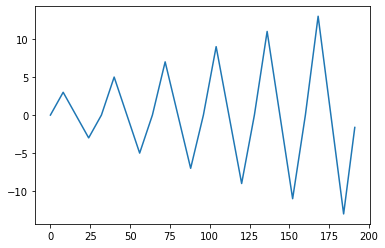

In [6]:
spec_val = h5['Measurement_000/Channel_000/Raw_Data-SHO_Fit_001/Spectroscopic_Values']
# spec = np.abs(np.array(h5['Measurement_000/Channel_000/Raw_Data']))
freq = h5['Measurement_000/Channel_000/Spectroscopic_Values']
# half the bias waveform as it is duplicated due to on-field and on-field concitions
voltage_step = np.zeros(int(spec_val[0,].shape[0]/2))

for i in range (int(spec_val[0,].shape[0]/2)):
  voltage_step[i] = spec_val[0,2*i]

print(np.shape(voltage_step))

plt.plot(voltage_step)

plt.show()

#Define and Plot Preisach plane from Waveform

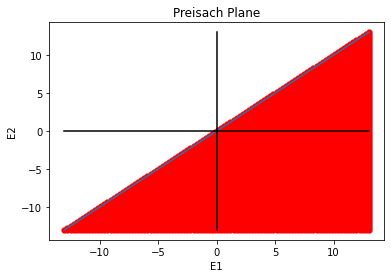

In [7]:
# Cal switching field

#E1 = voltage_step-np.min(voltage_step)
#E2 = voltage_step+np.min(voltage_step)
n_grid = 100
E1_grid = np.linspace(np.min(voltage_step), np.max(voltage_step), n_grid)
E2_grid = np.linspace(np.min(voltage_step), np.max(voltage_step), n_grid)
E1_grid, E2_grid = np.meshgrid(E1_grid, E2_grid)
E_fullplane = np.zeros((n_grid,n_grid,2))
for t1, (x1, x2) in enumerate(zip(E1_grid, E2_grid)):
  for t2, (xx1, xx2) in enumerate(zip(x1, x2)):
    if (xx1>=xx2):
      E_fullplane[t1, t2, 0] = xx1 #E1 values in Presiach plane E1>=E2
      E_fullplane[t1, t2, 1] = xx2 #E2 values in Presiach plane E1>=E2
    else:
      E_fullplane[t1, t2, 0] = np.inf  # 0 values NOT in Presiach plane E1>=E2
      E_fullplane[t1, t2, 1] = np.inf  # 0 values NOT in Presiach plane E1>=E2

E_fullplane = np.reshape(E_fullplane, (n_grid*n_grid,2))

#Preisach plane where E1 >= E2
E_Preisachplane = np.transpose(np.vstack((E_fullplane[~np.isinf(E_fullplane[:,0]),0], E_fullplane[~np.isinf(E_fullplane[:,1]),1])))



#E_diff = E1 - E2
#Plotting Presiach plane
plt.plot([np.min(voltage_step), np.max(voltage_step)], [np.min(voltage_step), np.max(voltage_step)])
plt.plot([0, 0], [np.min(voltage_step), np.max(voltage_step)], 'k-')
plt.plot([np.min(voltage_step), np.max(voltage_step)], [0, 0], 'k-')
plt.scatter(E_Preisachplane[:,0], E_Preisachplane[:,1], c='red',linewidth=0.2)
plt.xlabel('E1')
plt.ylabel('E2')
plt.title('Preisach Plane')
plt.show()
#plt.plot(E_diff)

#Now we segment the waveform such that we only sample the maximum and minimum points of each curve of V- and plot it on Preisach plane

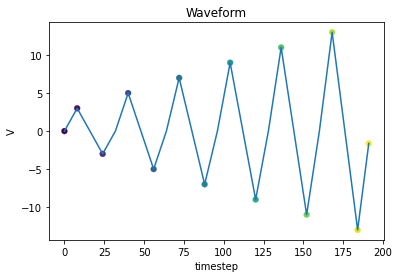

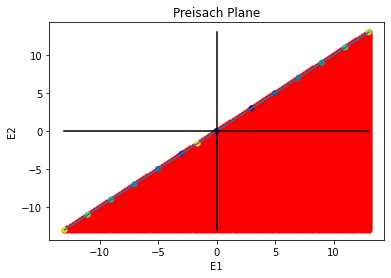

In [8]:
#Now we segment the waveform such that we only sample the maximum and minimum points of each curve of V
E_sample = np.zeros(1)
ind_sample = np.zeros(1)
for i in range(0,voltage_step.shape[0]):
  if (i==0): #Sample the first Voltage value
    E_sample = voltage_step[i]
    ind_sample = i
  elif (i==(voltage_step.shape[0]-1)): #Sample the last Voltage value
    E_sample = np.hstack((E_sample, voltage_step[-1]))
    ind_sample = np.hstack((ind_sample, i))
  else:
    if (np.sign(voltage_step[i]-voltage_step[i-1]) != np.sign(voltage_step[i+1]-voltage_step[i])):
      E_sample = np.hstack((E_sample, voltage_step[i]))
      ind_sample = np.hstack((ind_sample, i))


#Plot waveform and samples together
plt.plot(voltage_step)
plt.scatter(ind_sample, E_sample, c=ind_sample, cmap='viridis', linewidth = 0.2)
plt.xlabel('timestep')
plt.ylabel('V')
plt.title('Waveform')
plt.show()

#Plot Preisach plane and samples together
plt.plot([np.min(voltage_step), np.max(voltage_step)], [np.min(voltage_step), np.max(voltage_step)])
plt.plot([0, 0], [np.min(voltage_step), np.max(voltage_step)], 'k-')
plt.plot([np.min(voltage_step), np.max(voltage_step)], [0, 0], 'k-')
plt.scatter(E_Preisachplane[:,0], E_Preisachplane[:,1], c='red',linewidth=0.2)
plt.scatter(E_sample, E_sample, c=ind_sample, cmap='viridis', linewidth = 0.2)
plt.xlabel('E1')
plt.ylabel('E2')
plt.title('Preisach Plane')
plt.show()


#Now lets run the Preisach model to calculate the signal from the hysteron state over the defined Preisach plane, across the waveform

- This will develop loops along V (waveform)

#User Input:

**Choice** parameter is the user chosen initialization of the state of hysterons, depending on the knowledge we have on the starting value of waveform.

- If we start with minimum waveform (extreme), then **choice = "Vmin"** -- we start with sweeping left-right

- If we start with maximum waveform (extreme), then **choice = "Vmax"** -- we start with sweeping top-bottom

- If we start with any values between the extremes and dont know how should be sweep, then there are three options that we can choose as below,

**choice = "on"** -- we start with all hysterons switch on

**choice = "off"** -- we start with all hysterons switch off

**choice = "random"** -- we start with all hysterons either switch on/off as randomly sampled from Bernoulli(p). **Most interesting one**


#In this waveform, we know we start with Vmin so, choice = "Vmin"

- See the hysteron switching over Preisach plane - light (yellow region) is switch on and dark (violet) region is switch off. 
- The hysteron switch plot is superimposed on density function plot. 
- The reversible density is the delta function which has values only at the diagonal of the plane (highlighted by black line)
- The irreversible density is Gaussian as highlighted over the plane. The highlight intensity defines the strength of the density.
- Finally with the switch of the hysterons and the density function superimposed, we generate the signals which create loops gradually

Analysis: 1 of 192


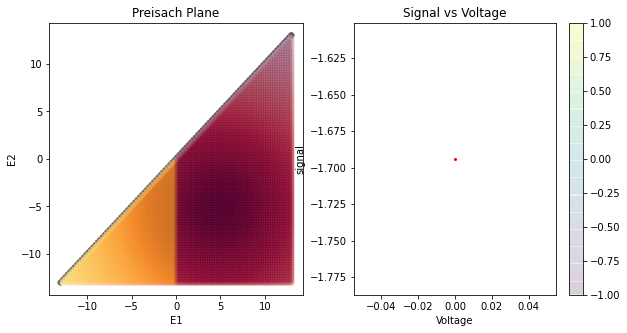

Analysis: 2 of 192


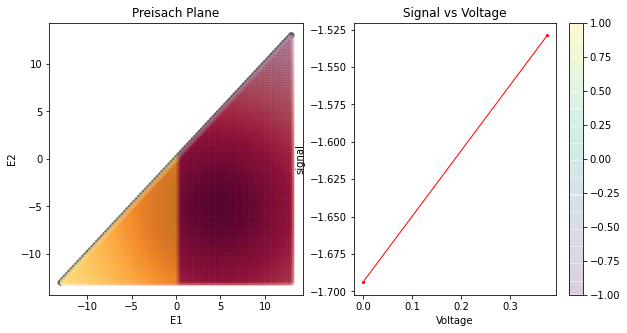

Analysis: 3 of 192


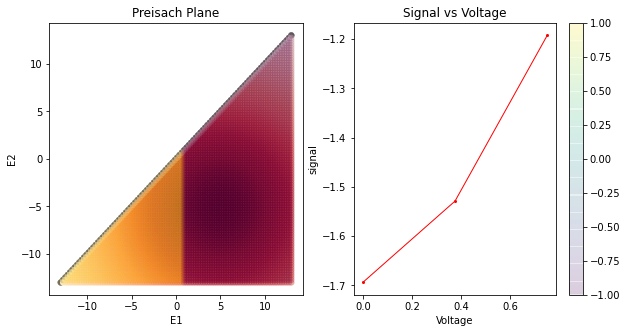

Analysis: 4 of 192


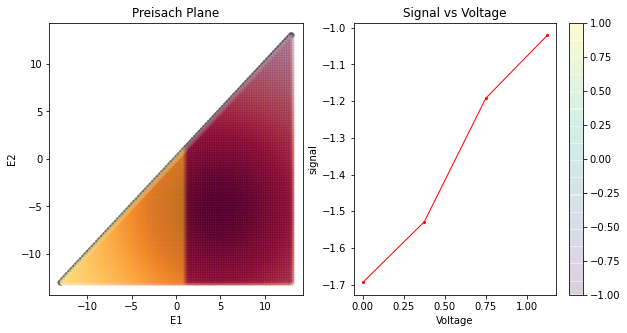

Analysis: 5 of 192


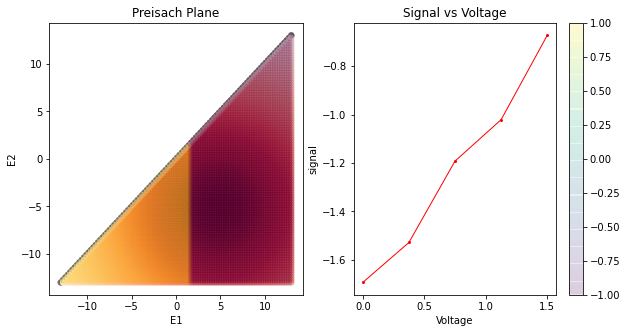

Analysis: 6 of 192


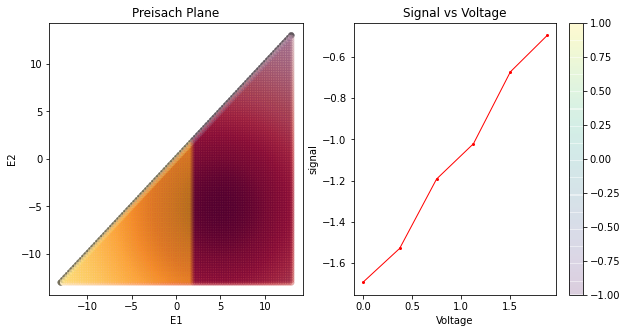

Analysis: 7 of 192


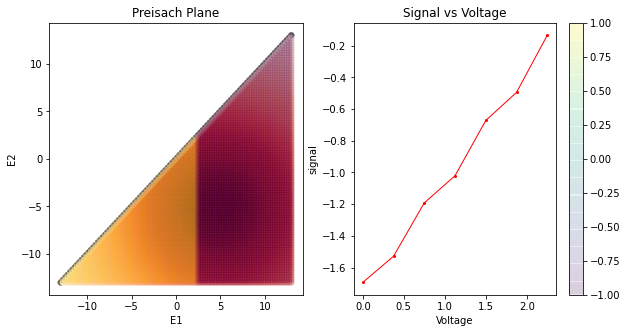

Analysis: 8 of 192


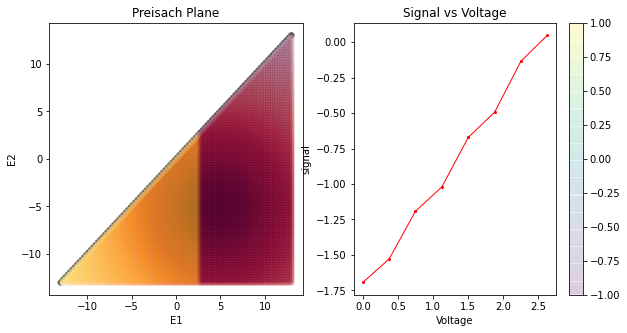

Analysis: 9 of 192


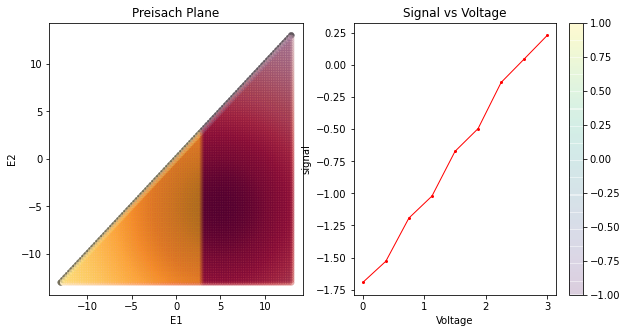

Analysis: 10 of 192


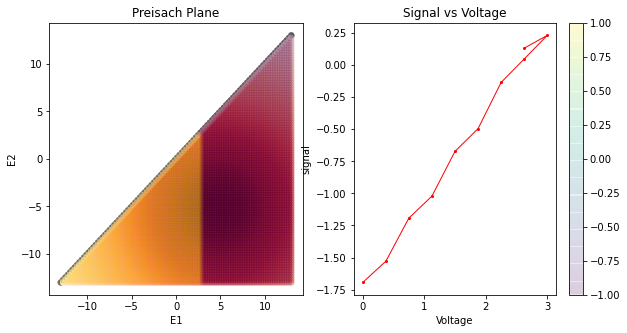

Analysis: 11 of 192


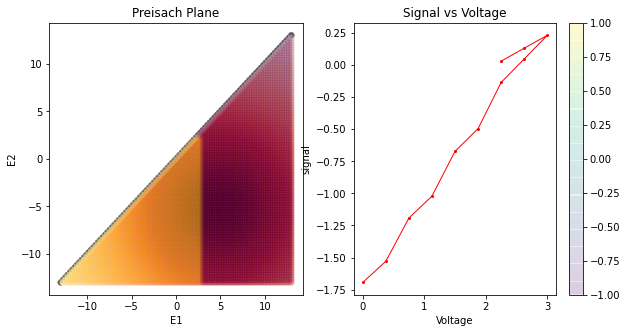

Analysis: 12 of 192


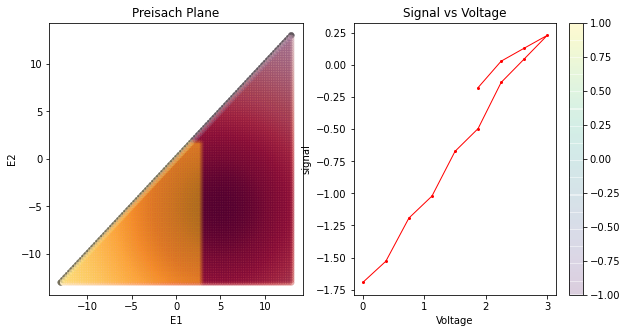

Analysis: 13 of 192


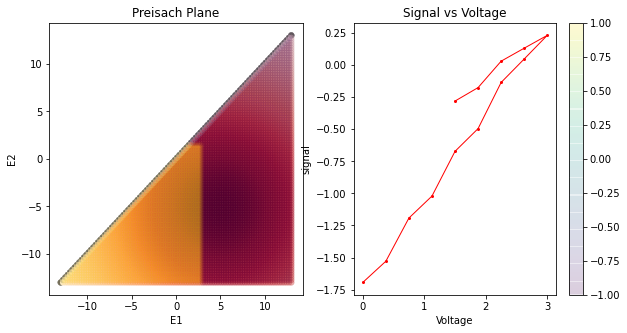

Analysis: 14 of 192


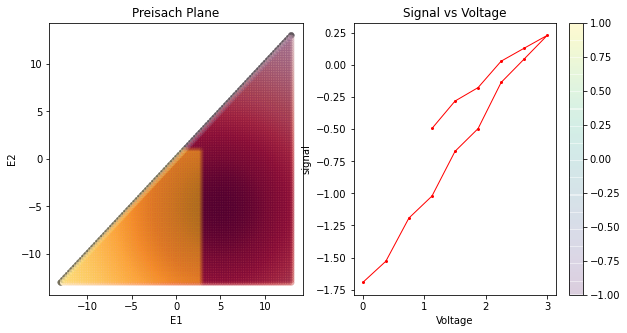

Analysis: 15 of 192


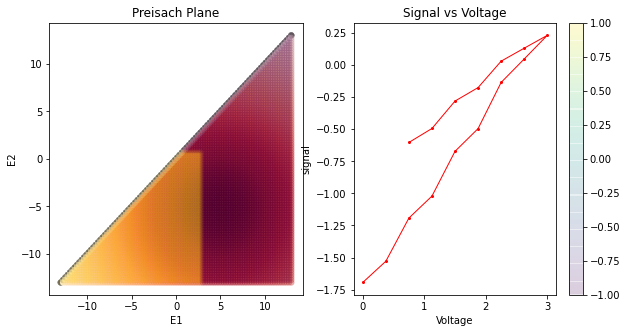

Analysis: 16 of 192


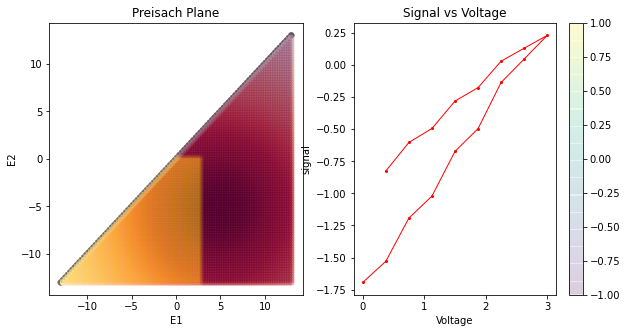

Analysis: 17 of 192


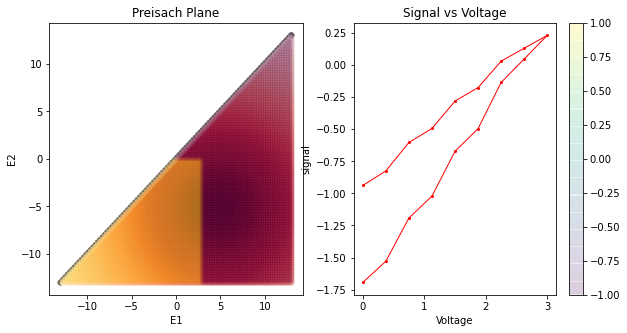

Analysis: 18 of 192


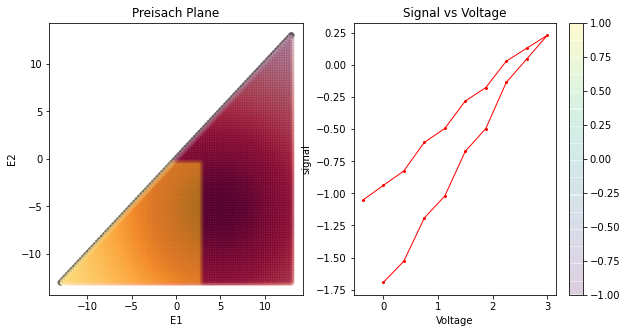

Analysis: 19 of 192


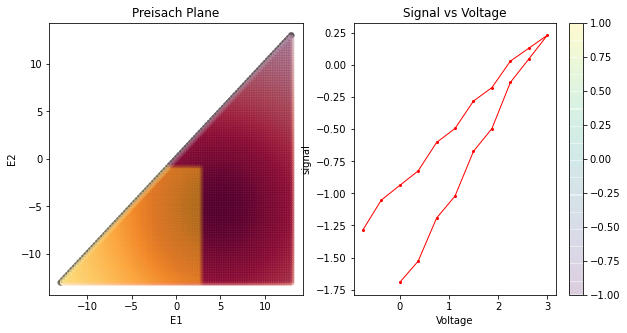

Analysis: 20 of 192


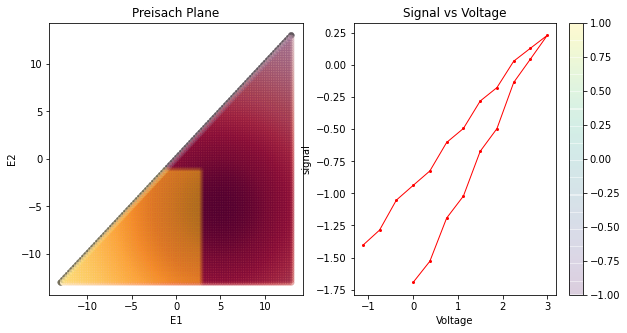

Analysis: 21 of 192


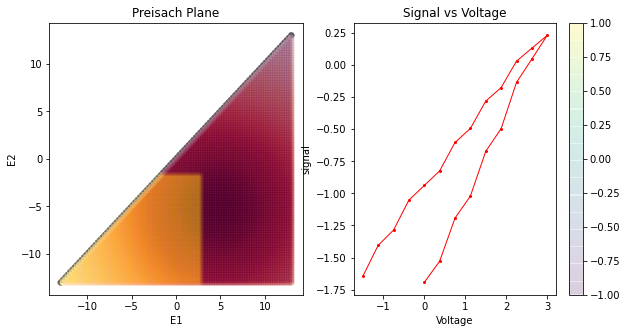

Analysis: 22 of 192


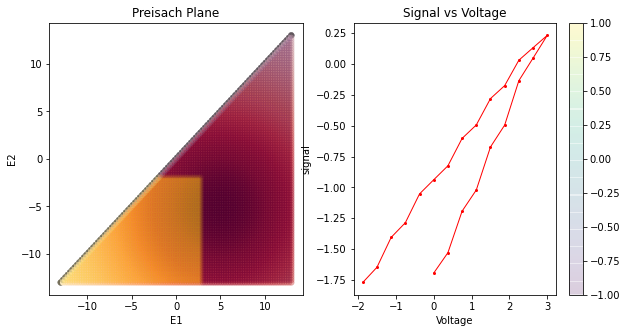

Analysis: 23 of 192


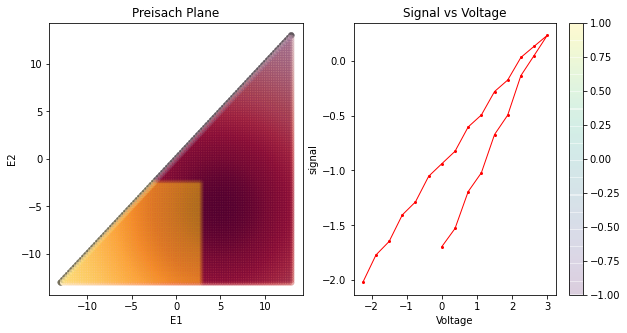

Analysis: 24 of 192


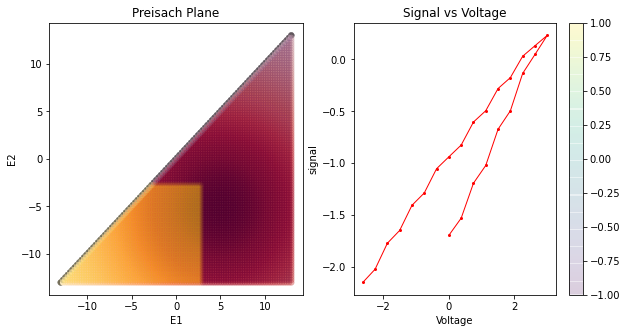

Analysis: 25 of 192


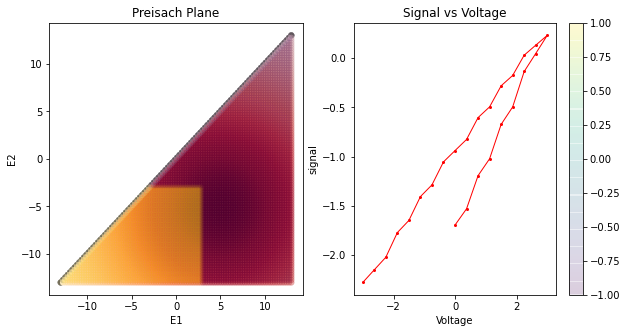

Analysis: 26 of 192


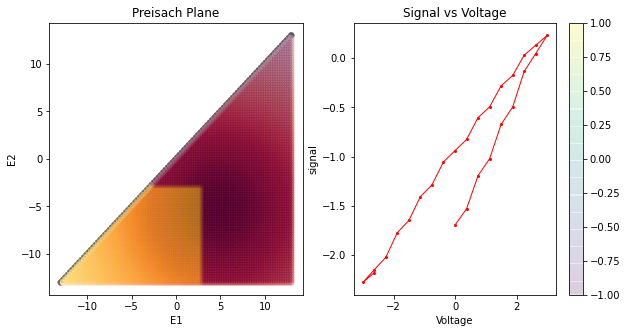

Analysis: 27 of 192


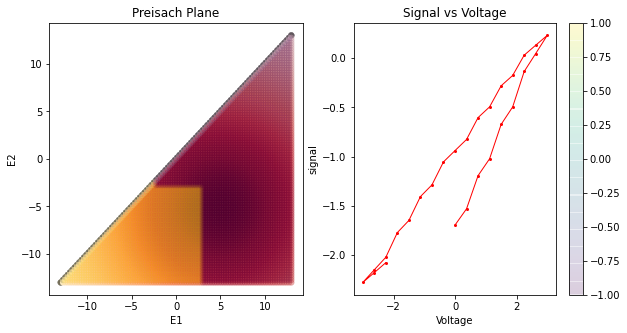

Analysis: 28 of 192


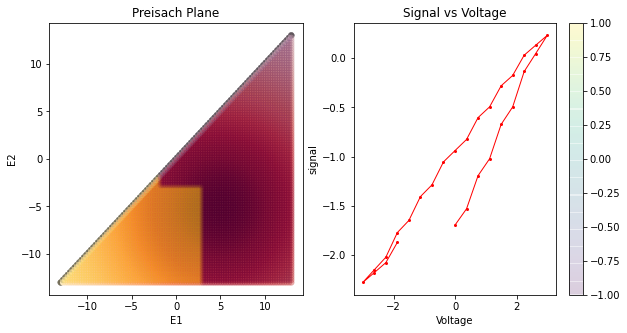

Analysis: 29 of 192


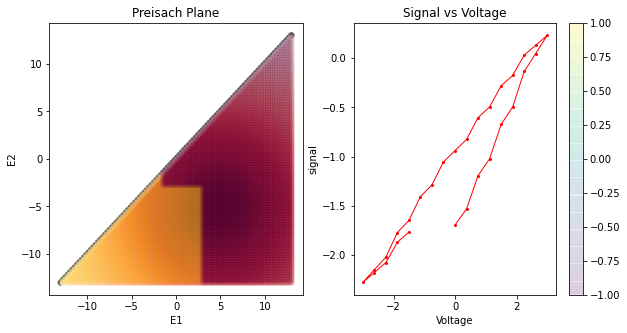

Analysis: 30 of 192


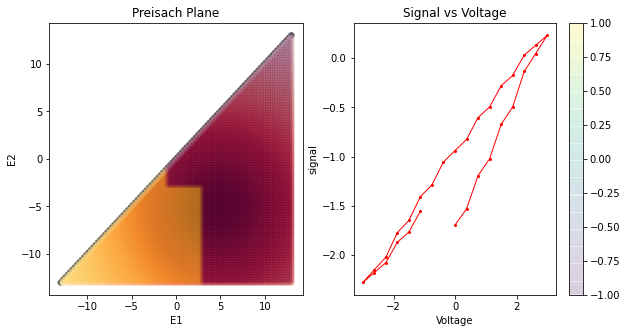

Analysis: 31 of 192


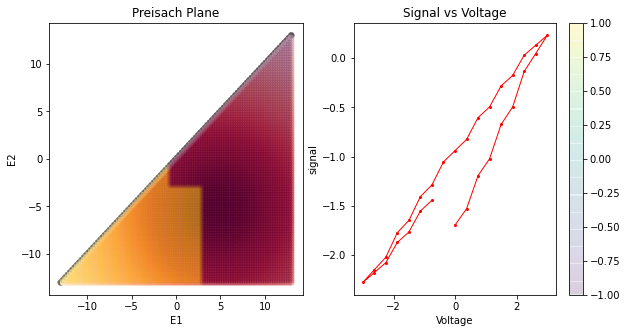

Analysis: 32 of 192


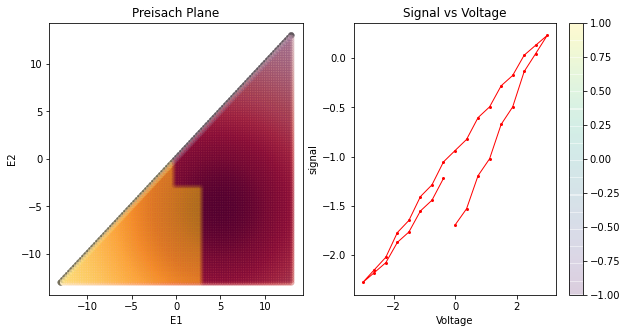

Analysis: 33 of 192


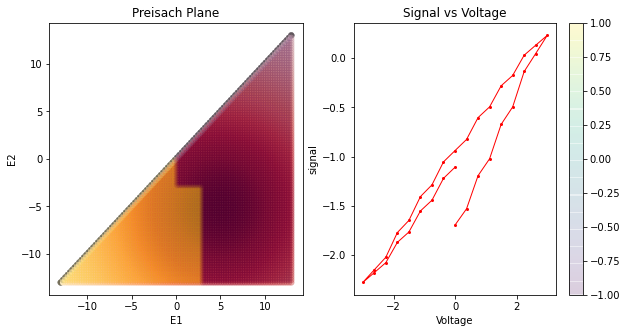

Analysis: 34 of 192


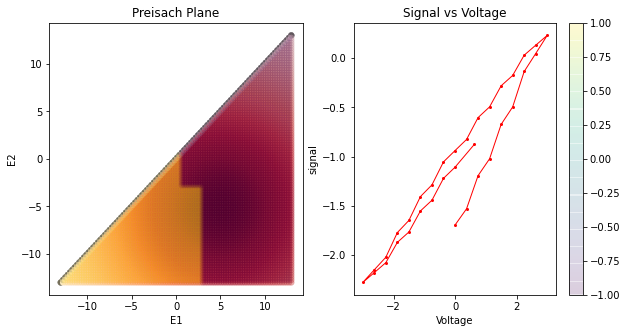

Analysis: 35 of 192


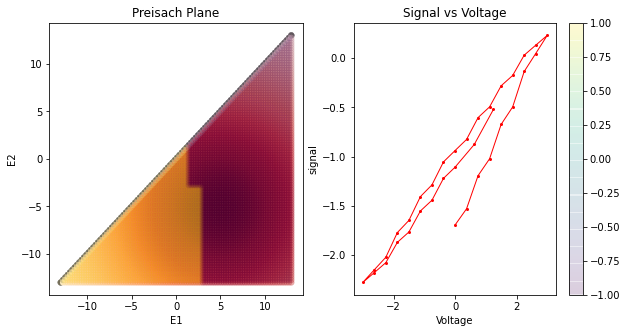

Analysis: 36 of 192


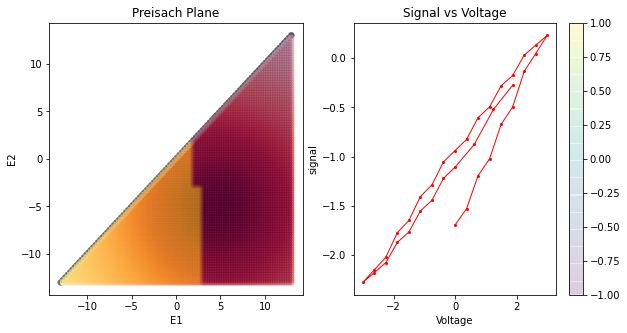

Analysis: 37 of 192


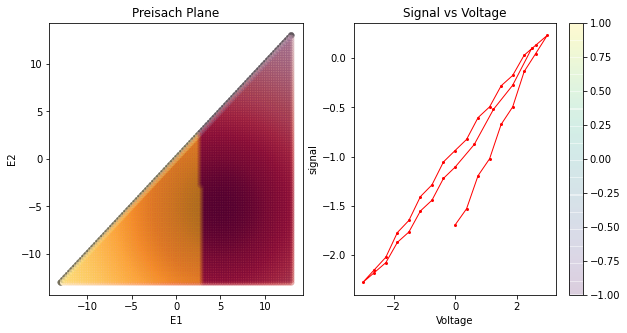

Analysis: 38 of 192


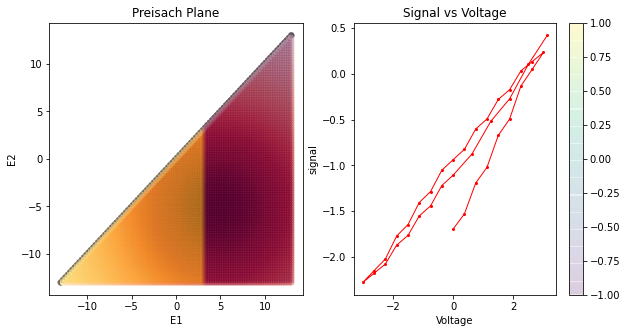

Analysis: 39 of 192


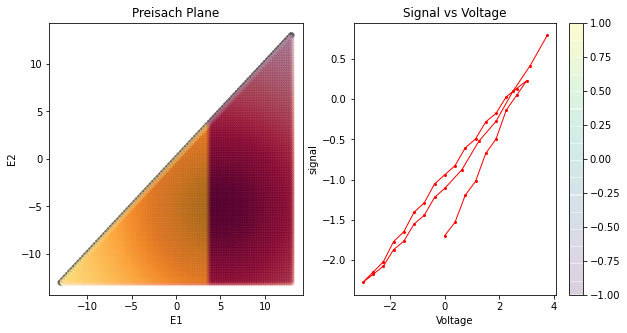

Analysis: 40 of 192


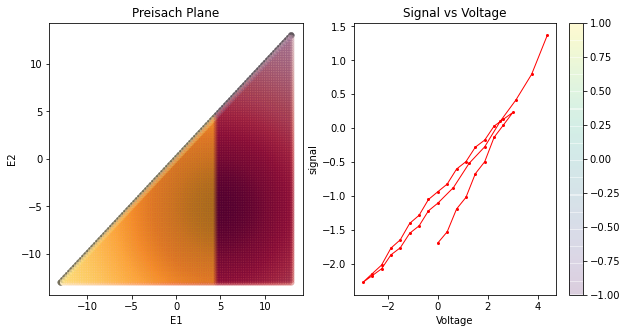

Analysis: 41 of 192


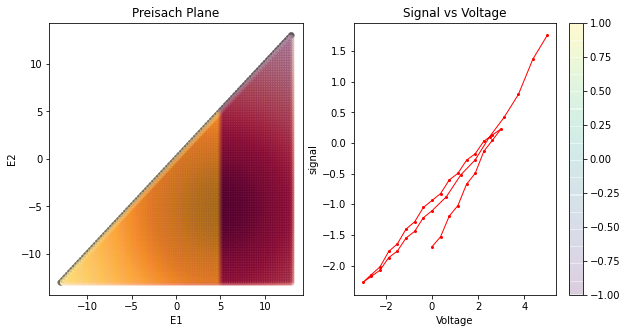

Analysis: 42 of 192


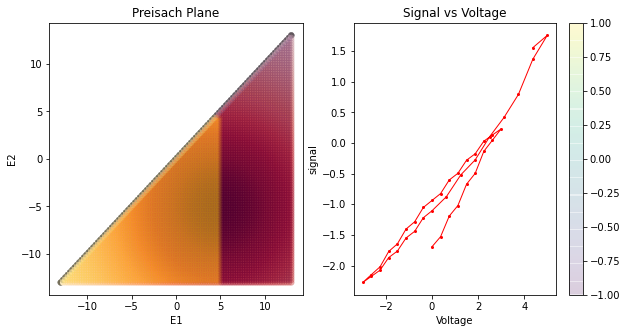

Analysis: 43 of 192


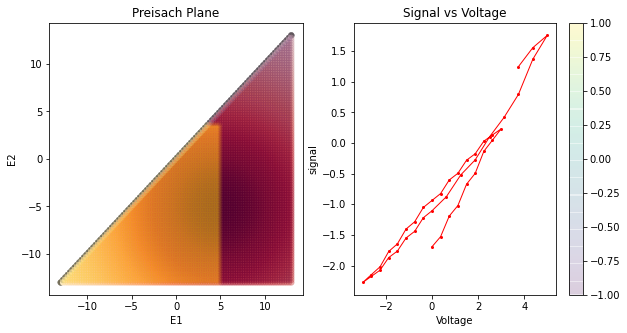

Analysis: 44 of 192


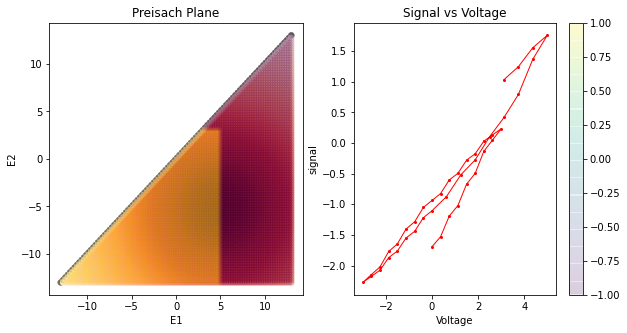

Analysis: 45 of 192


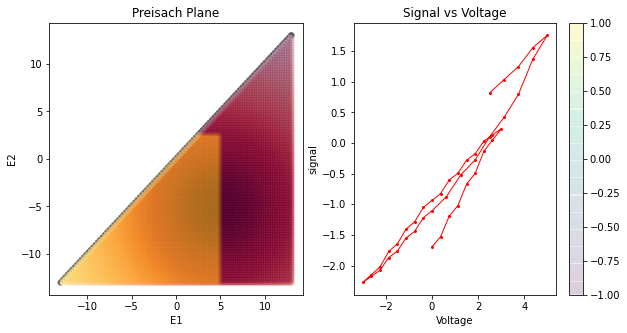

Analysis: 46 of 192


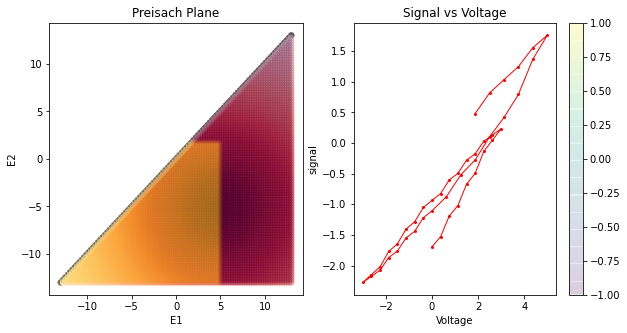

Analysis: 47 of 192


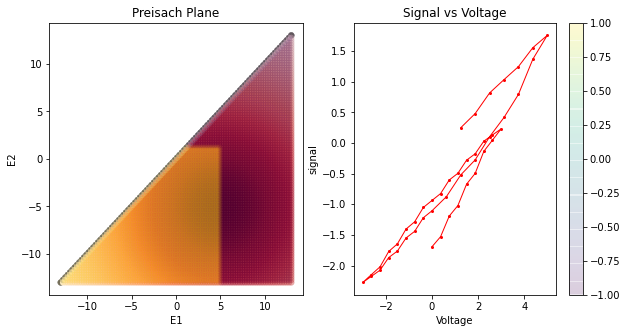

Analysis: 48 of 192


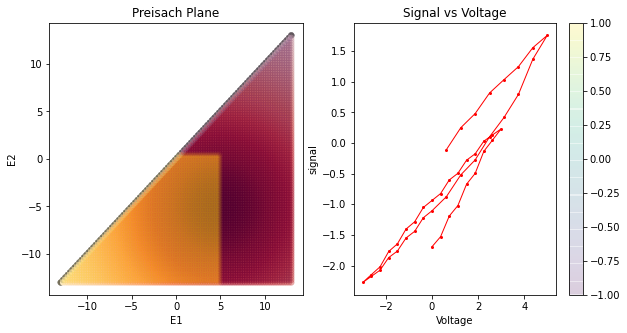

Analysis: 49 of 192


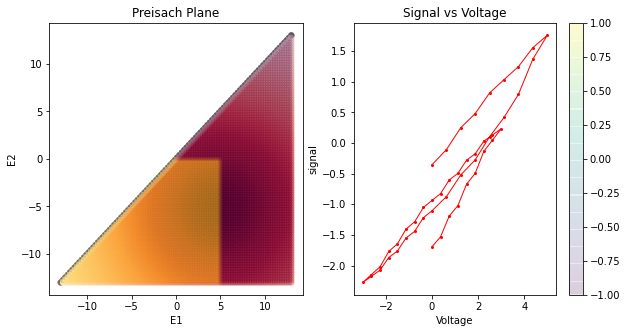

Analysis: 50 of 192


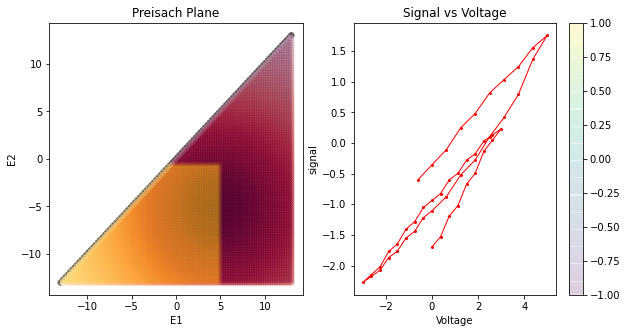

Analysis: 51 of 192


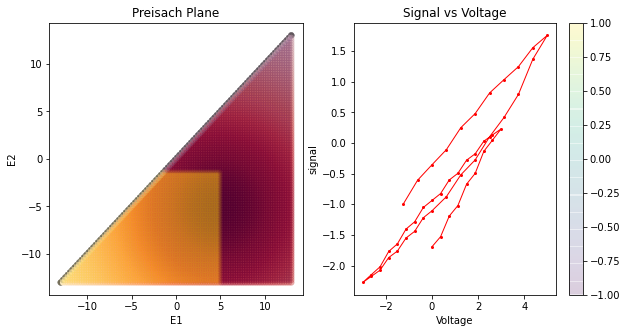

Analysis: 52 of 192


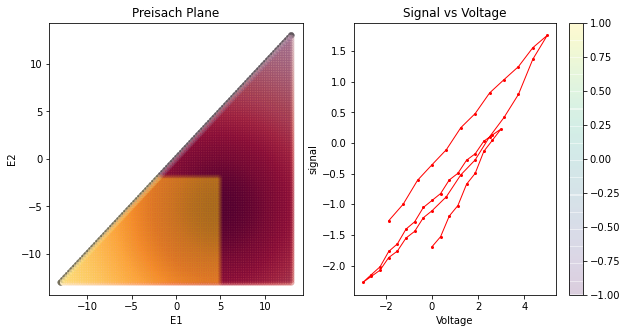

Analysis: 53 of 192


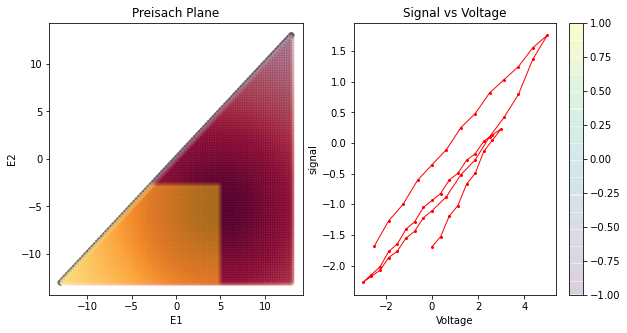

Analysis: 54 of 192


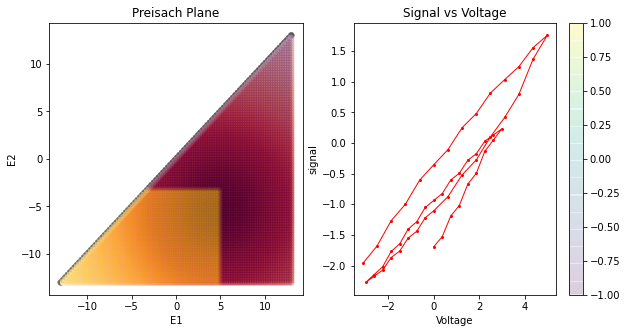

Analysis: 55 of 192


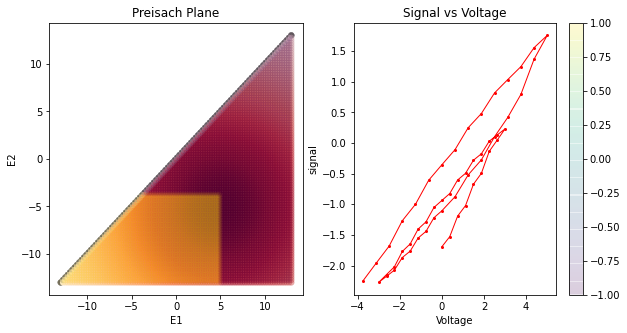

Analysis: 56 of 192


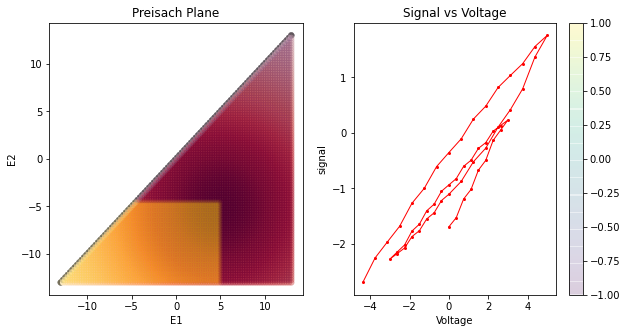

Analysis: 57 of 192


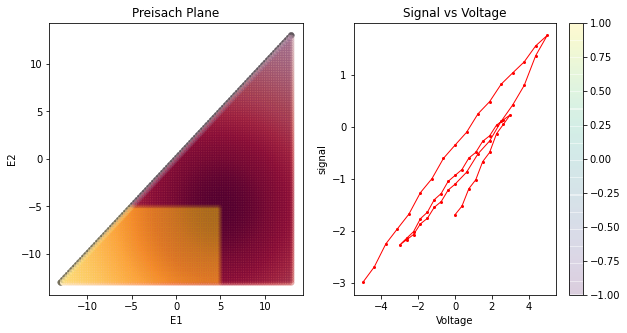

Analysis: 58 of 192


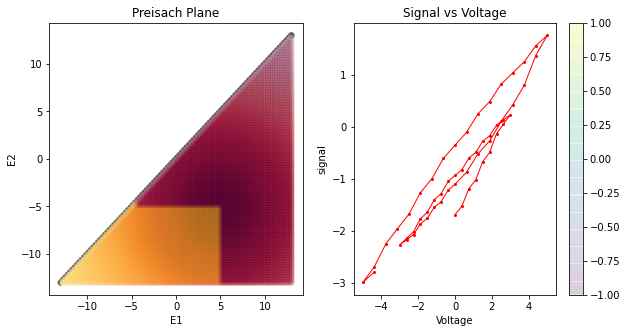

Analysis: 59 of 192


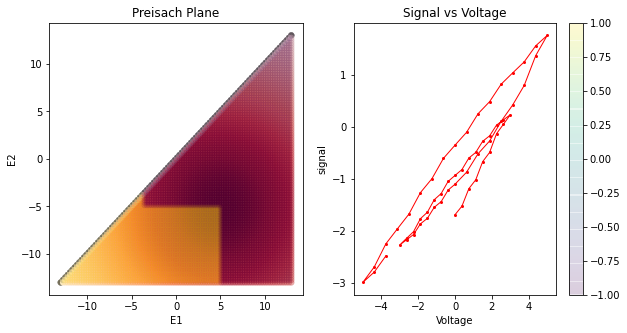

Analysis: 60 of 192


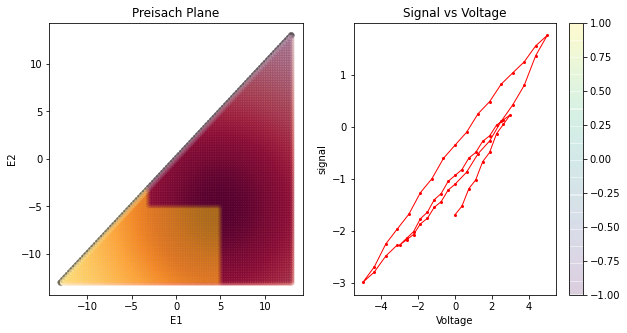

Analysis: 61 of 192


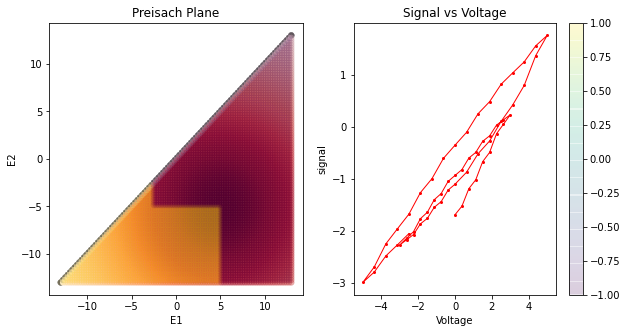

Analysis: 62 of 192


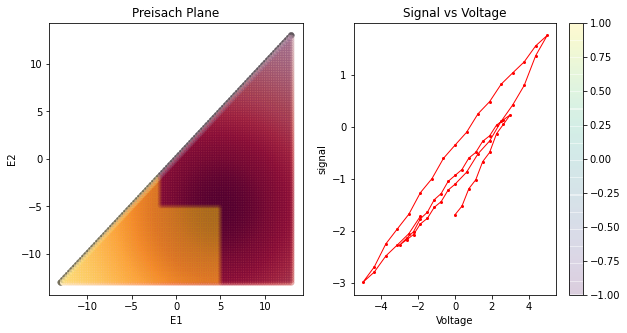

Analysis: 63 of 192


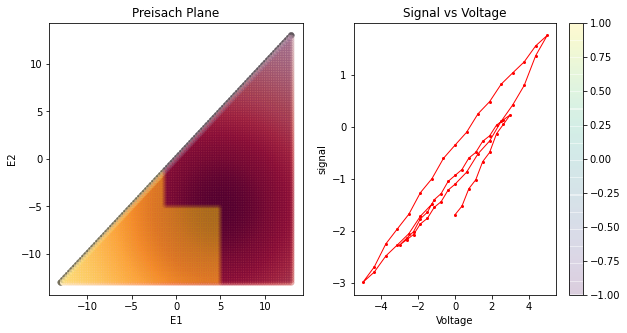

Analysis: 64 of 192


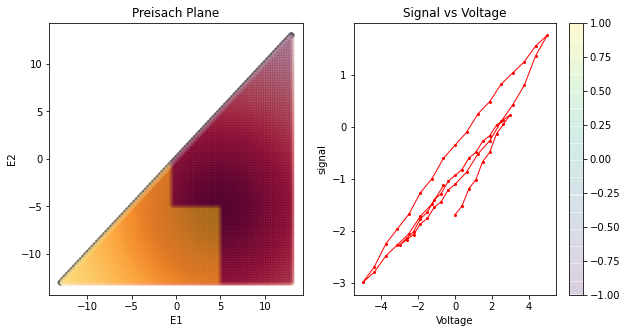

Analysis: 65 of 192


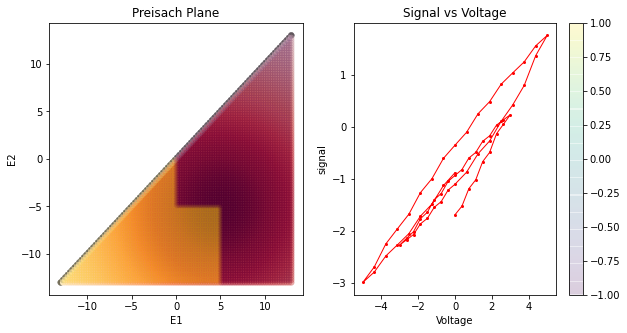

Analysis: 66 of 192


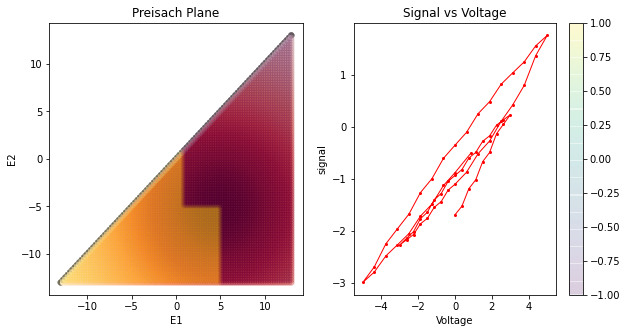

Analysis: 67 of 192


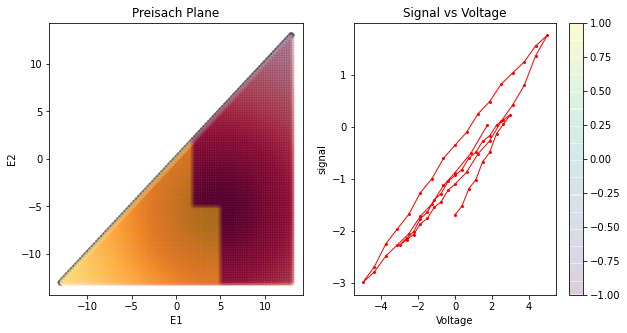

Analysis: 68 of 192


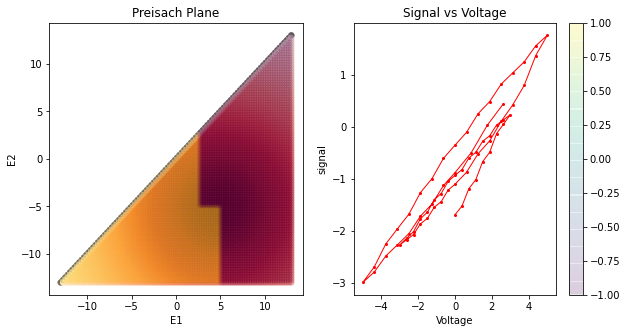

Analysis: 69 of 192


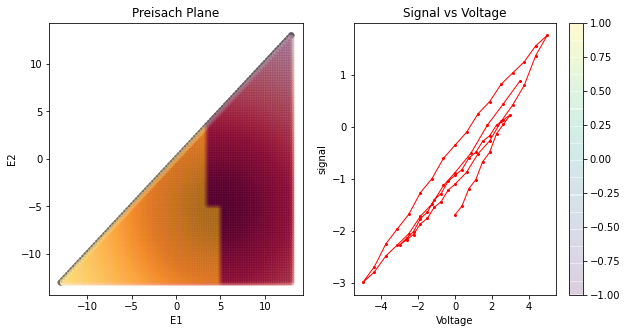

Analysis: 70 of 192


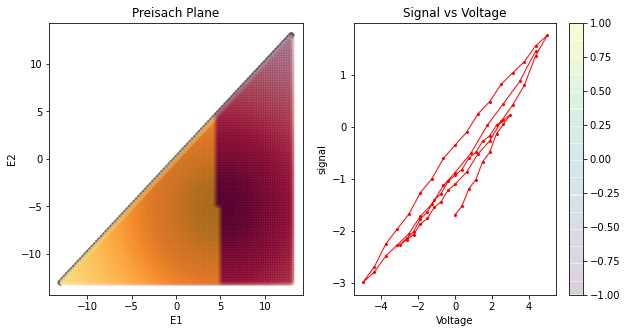

Analysis: 71 of 192


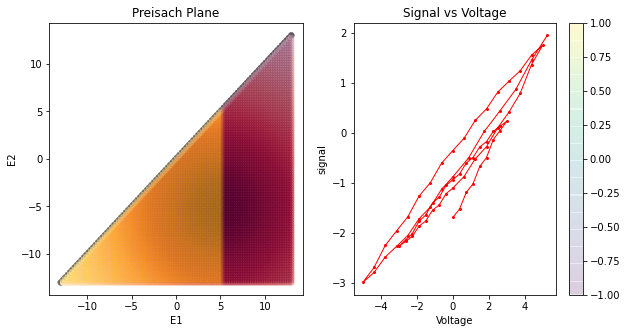

Analysis: 72 of 192


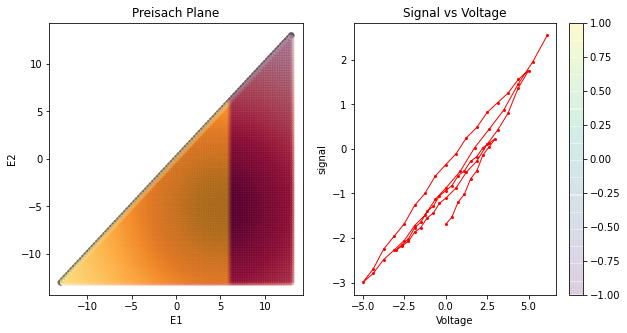

Analysis: 73 of 192


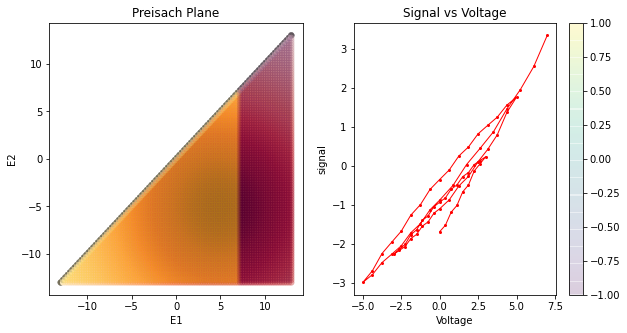

Analysis: 74 of 192


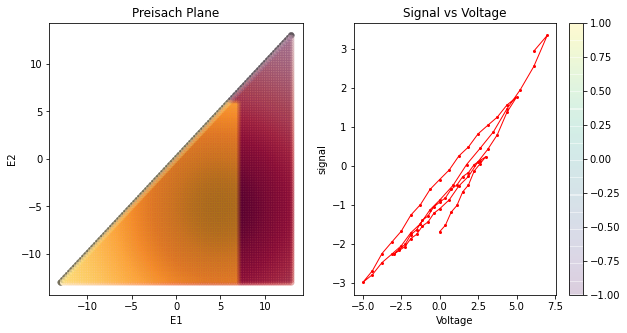

Analysis: 75 of 192


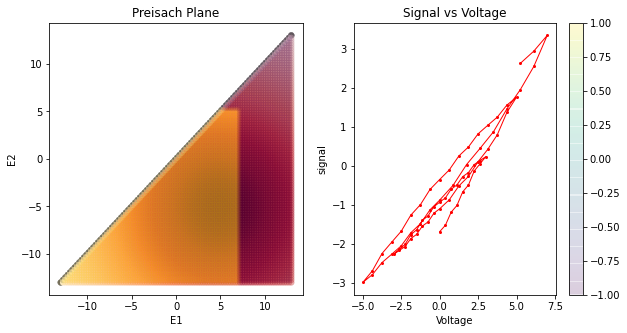

Analysis: 76 of 192


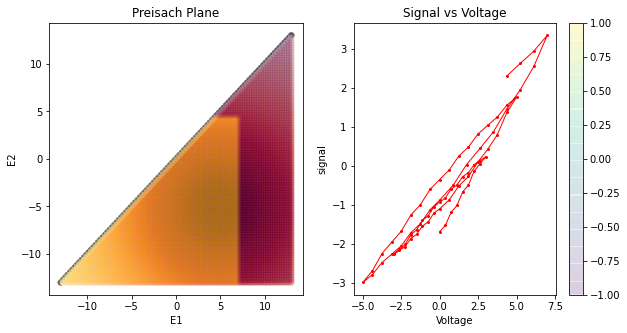

Analysis: 77 of 192


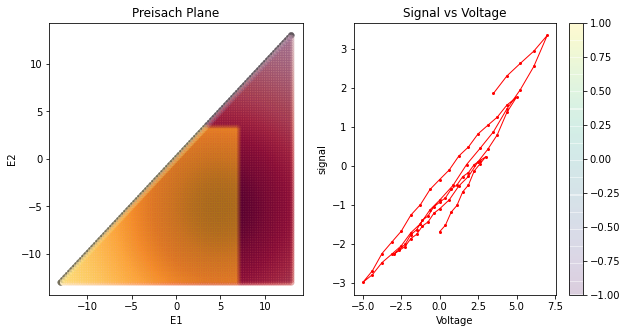

Analysis: 78 of 192


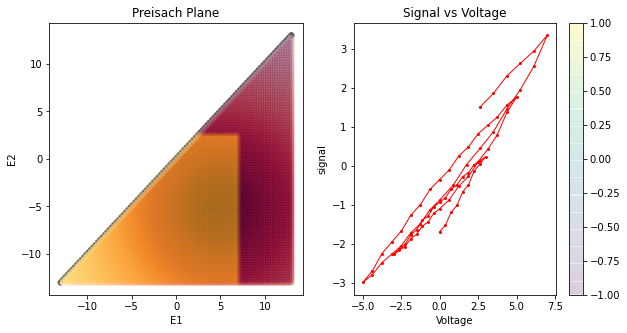

Analysis: 79 of 192


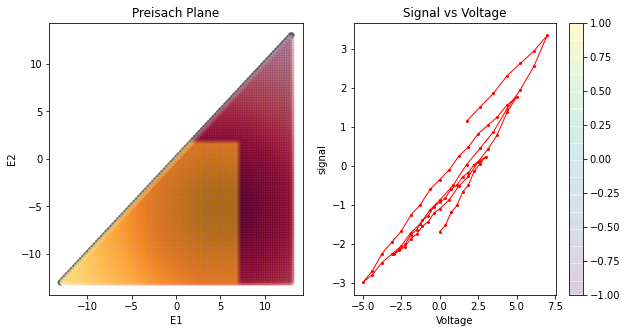

Analysis: 80 of 192


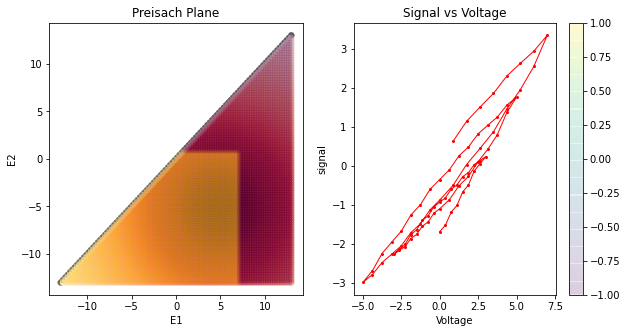

Analysis: 81 of 192


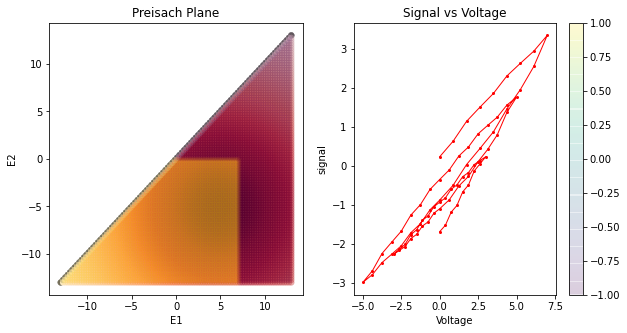

Analysis: 82 of 192


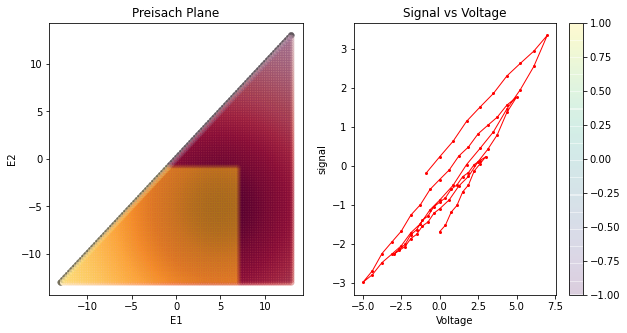

Analysis: 83 of 192


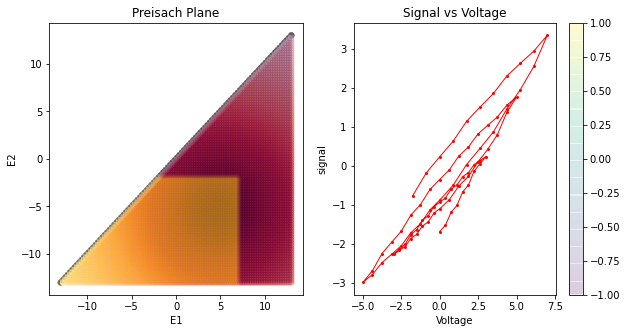

Analysis: 84 of 192


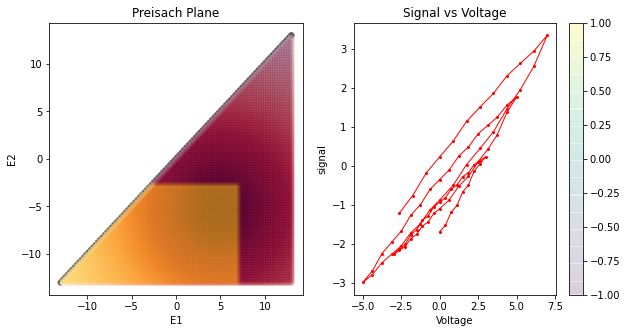

Analysis: 85 of 192


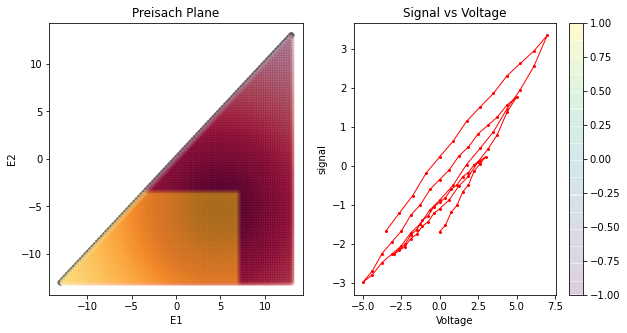

Analysis: 86 of 192


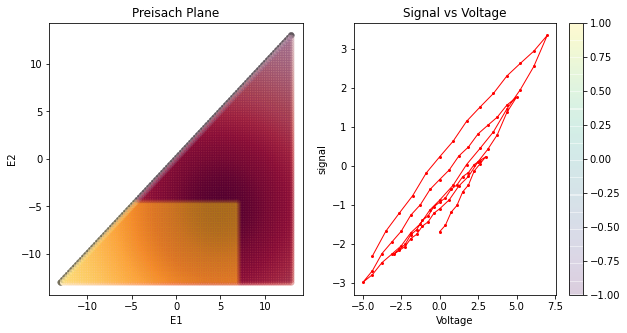

Analysis: 87 of 192


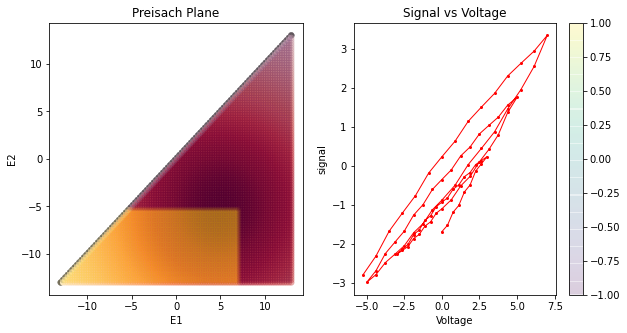

Analysis: 88 of 192


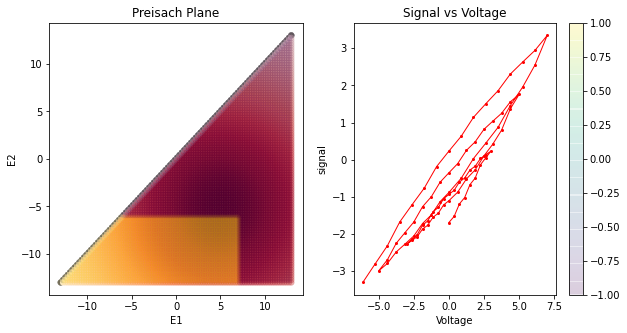

Analysis: 89 of 192


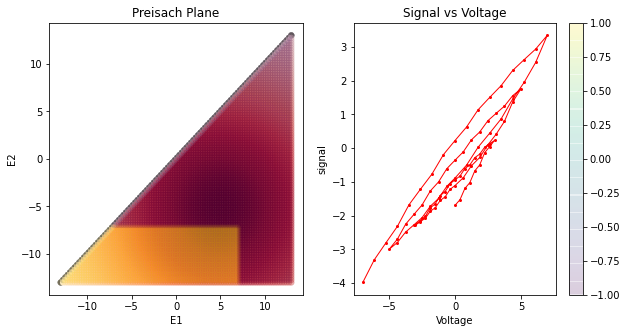

Analysis: 90 of 192


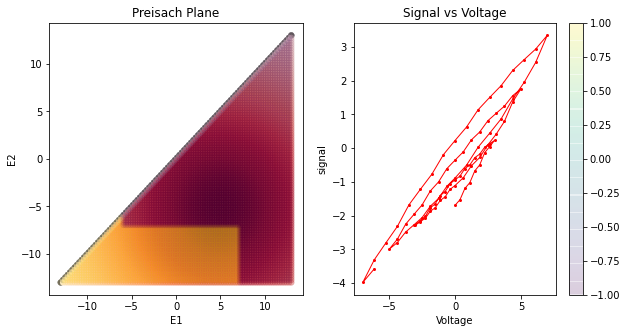

Analysis: 91 of 192


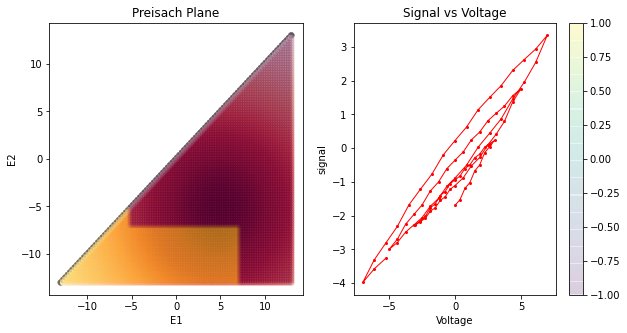

Analysis: 92 of 192


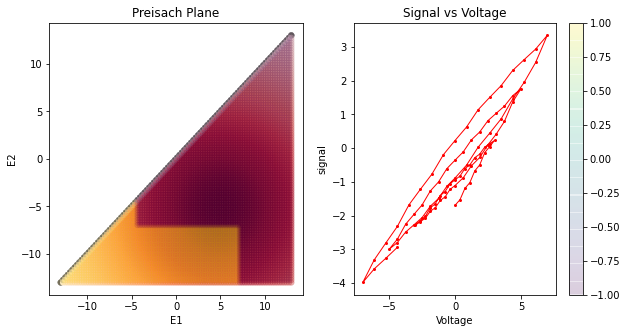

Analysis: 93 of 192


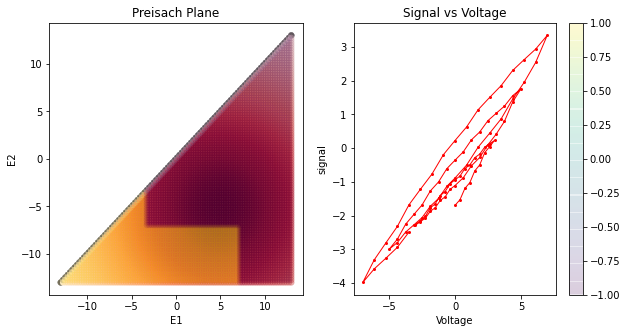

Analysis: 94 of 192


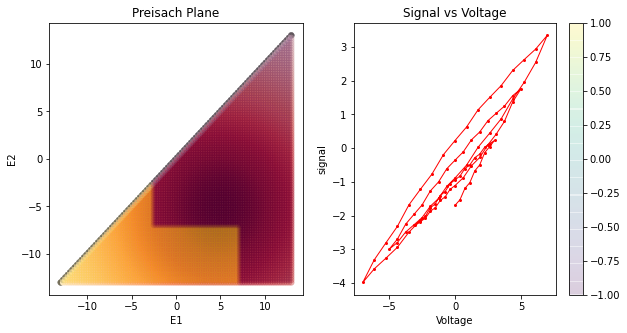

Analysis: 95 of 192


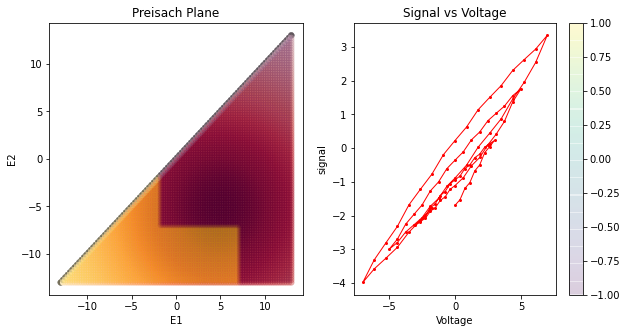

Analysis: 96 of 192


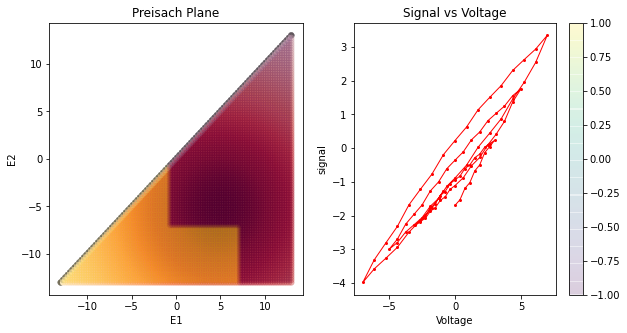

Analysis: 97 of 192


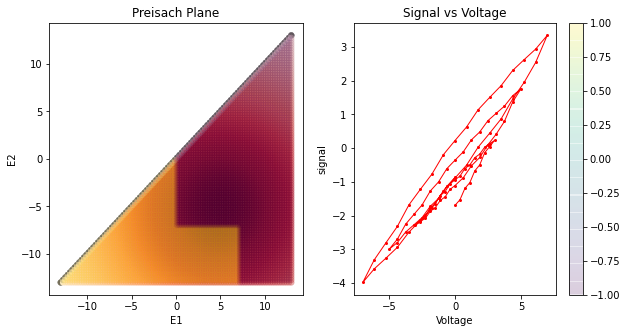

Analysis: 98 of 192


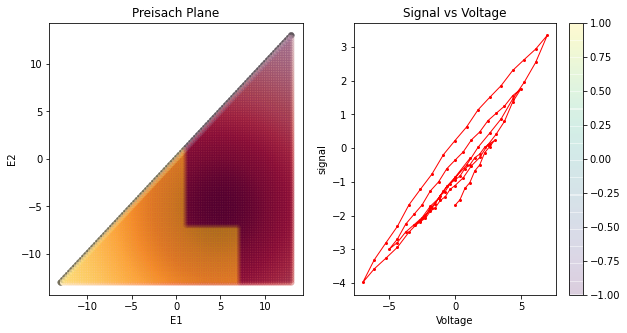

Analysis: 99 of 192


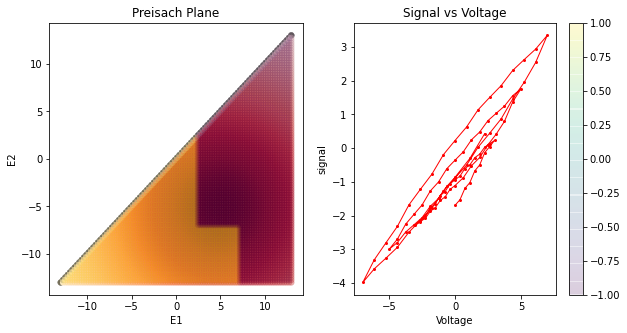

Analysis: 100 of 192


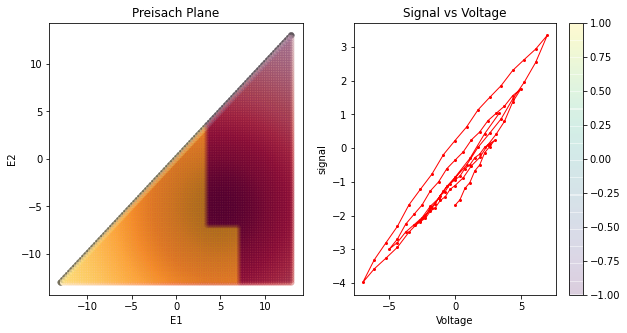

Analysis: 101 of 192


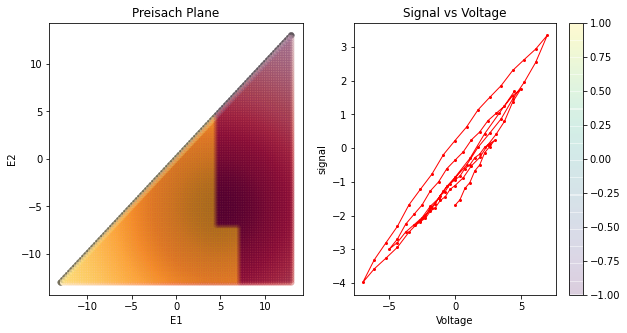

Analysis: 102 of 192


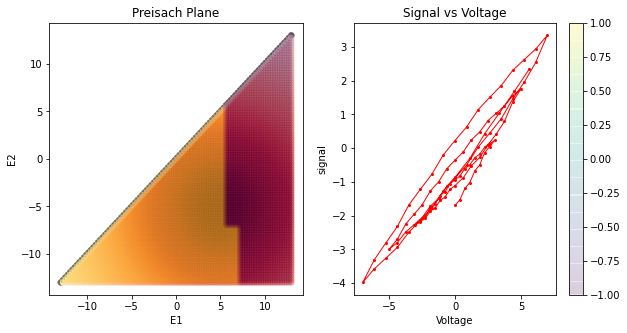

Analysis: 103 of 192


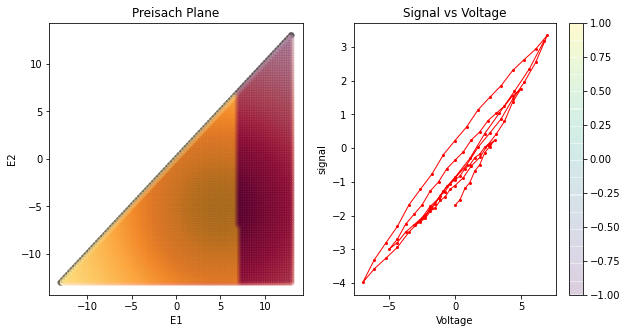

Analysis: 104 of 192


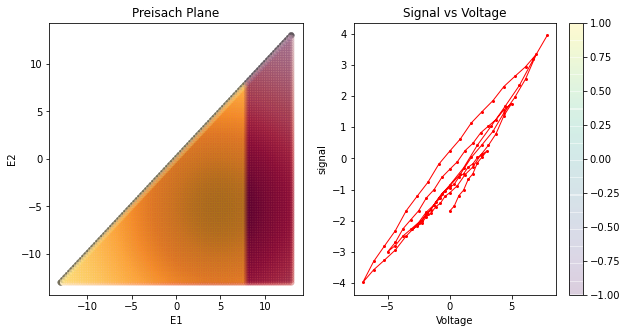

Analysis: 105 of 192


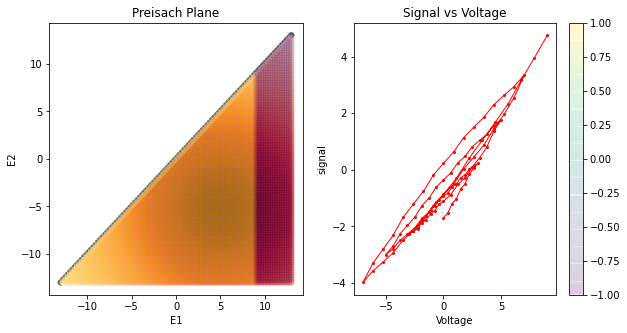

Analysis: 106 of 192


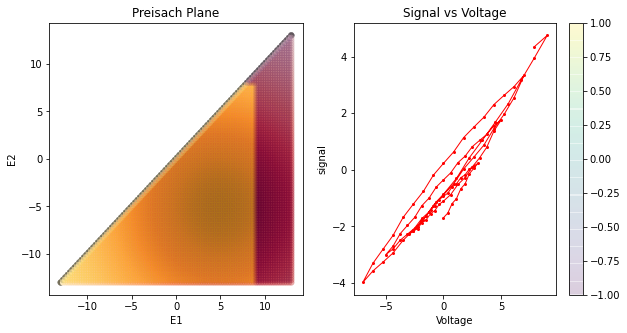

Analysis: 107 of 192


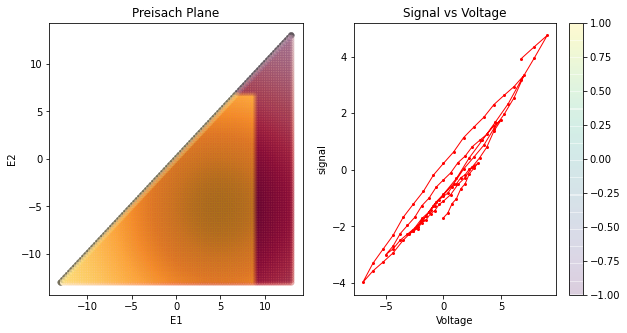

Analysis: 108 of 192


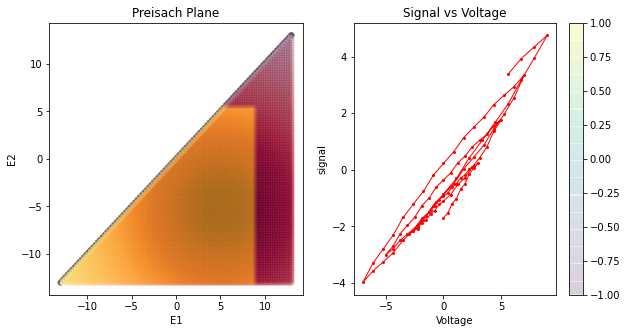

Analysis: 109 of 192


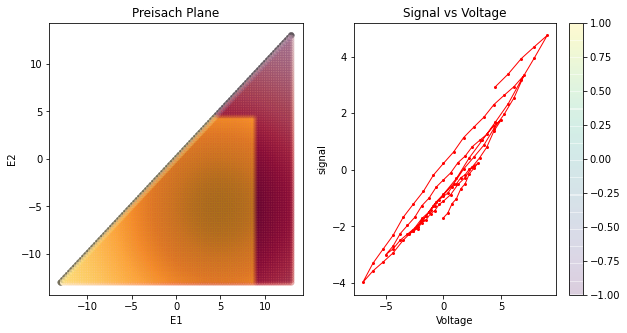

Analysis: 110 of 192


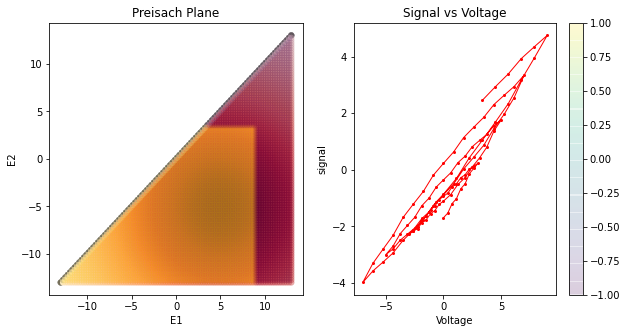

Analysis: 111 of 192


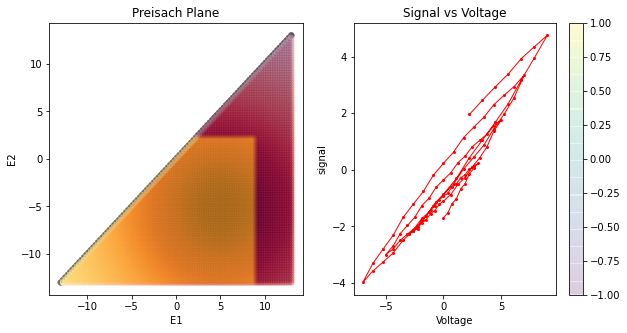

Analysis: 112 of 192


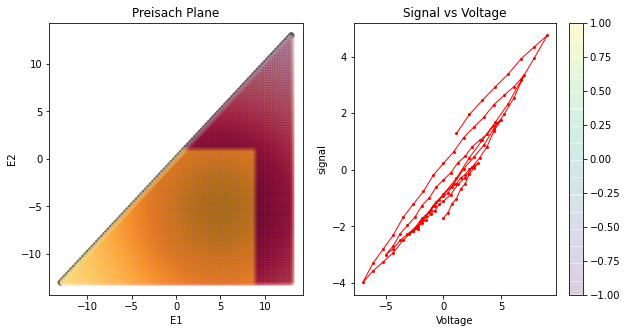

Analysis: 113 of 192


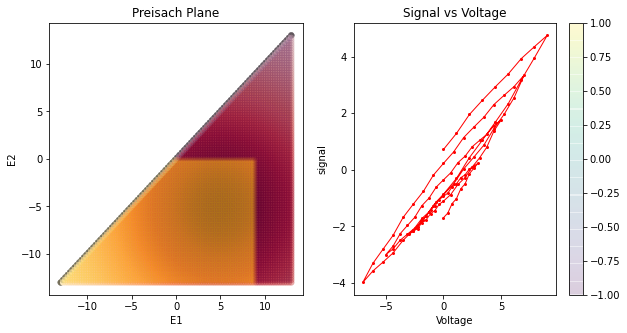

Analysis: 114 of 192


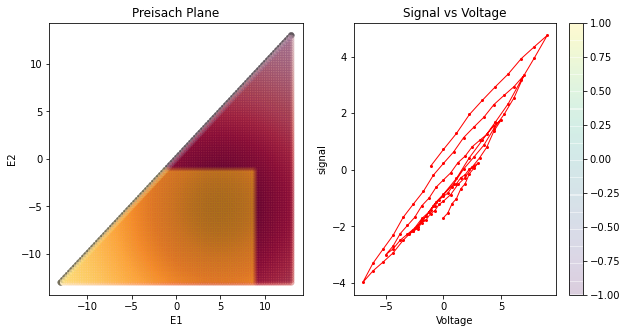

Analysis: 115 of 192


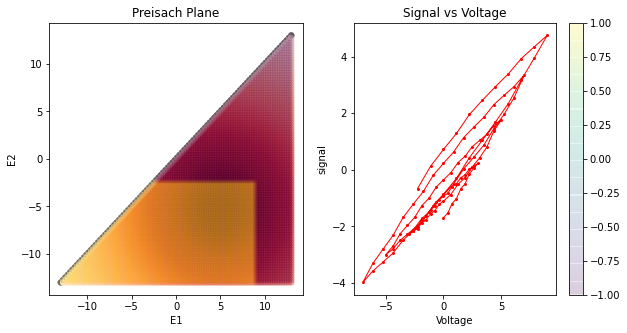

Analysis: 116 of 192


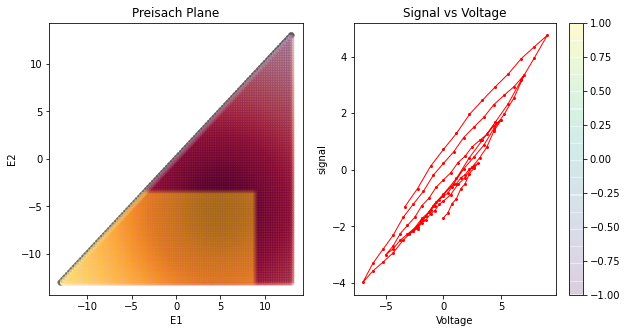

Analysis: 117 of 192


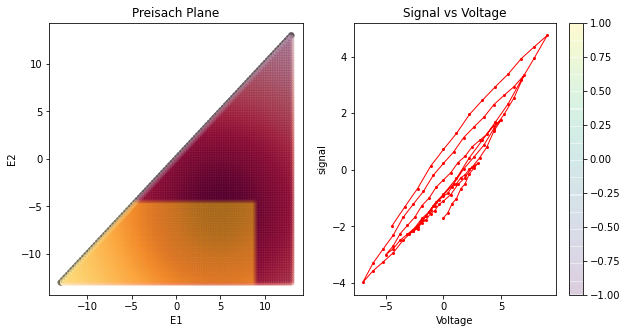

Analysis: 118 of 192


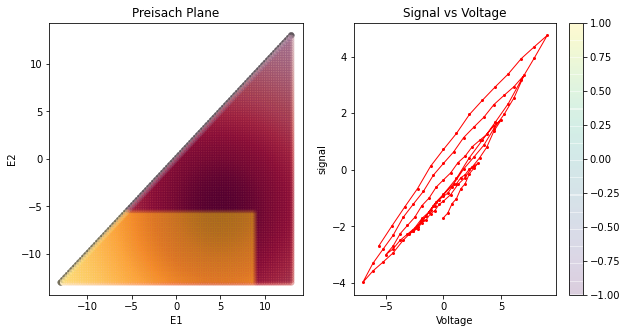

Analysis: 119 of 192


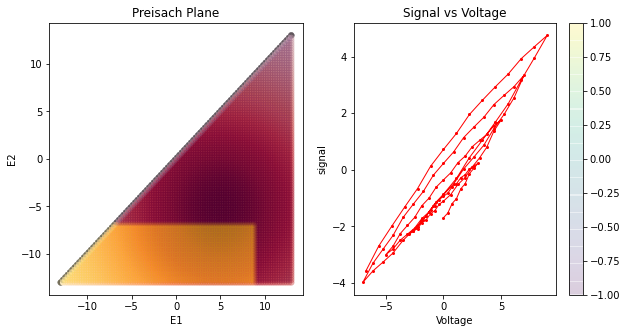

Analysis: 120 of 192


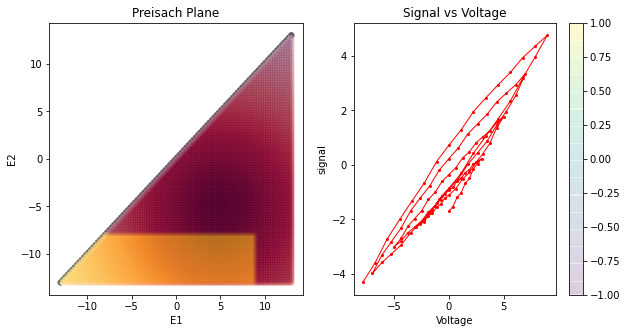

Analysis: 121 of 192


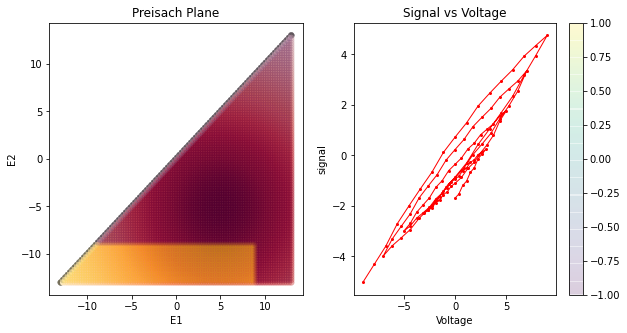

Analysis: 122 of 192


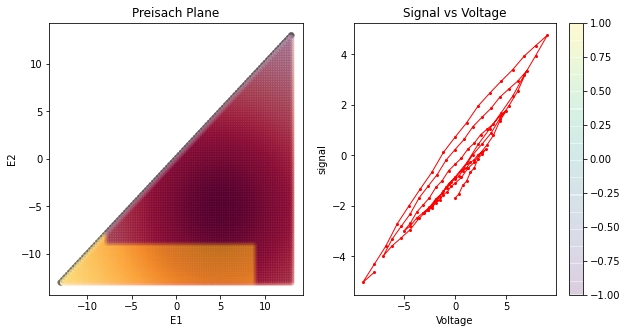

Analysis: 123 of 192


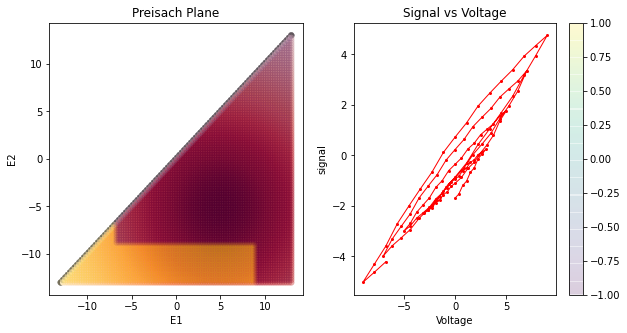

Analysis: 124 of 192


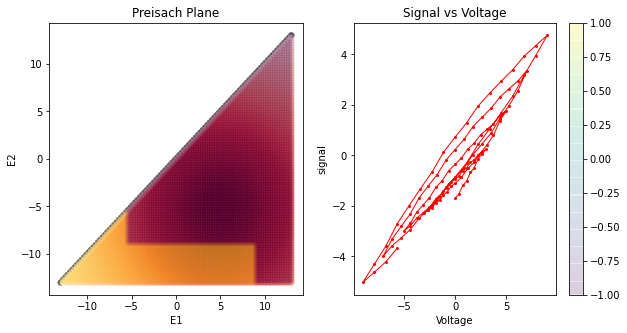

Analysis: 125 of 192


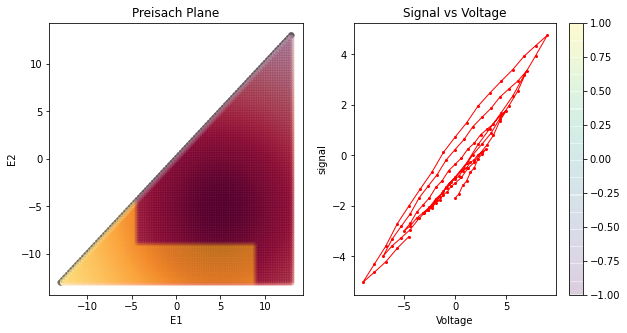

Analysis: 126 of 192


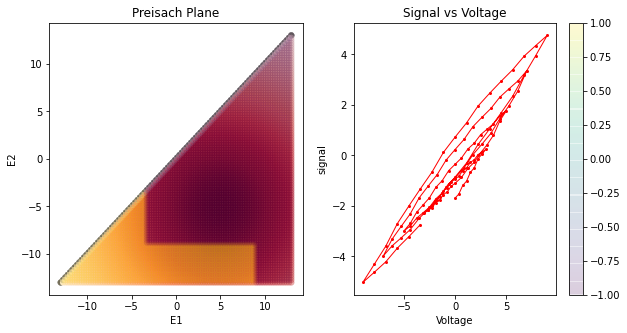

Analysis: 127 of 192


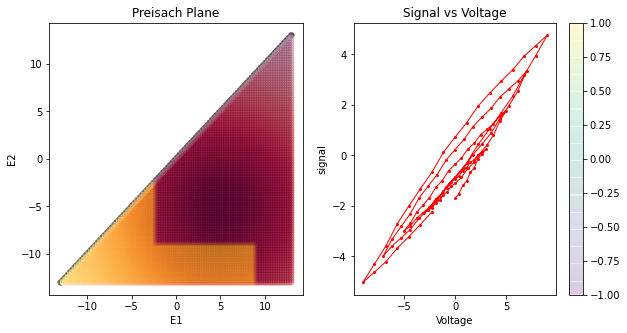

Analysis: 128 of 192


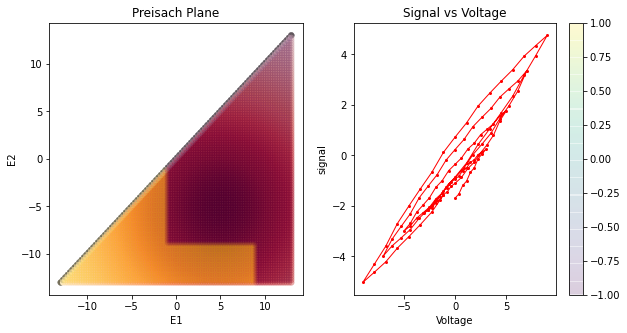

Analysis: 129 of 192


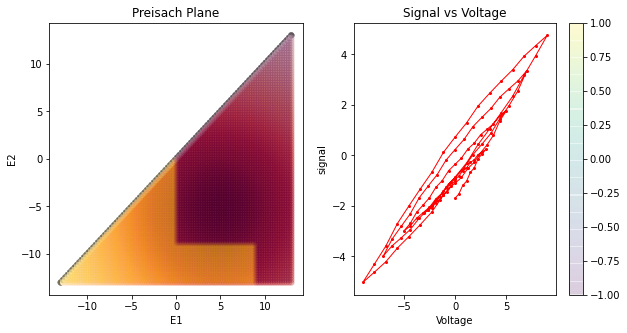

Analysis: 130 of 192


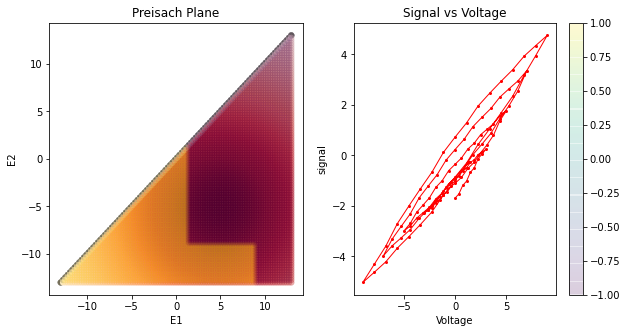

Analysis: 131 of 192


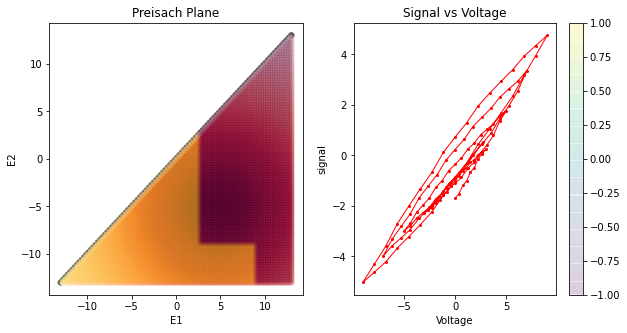

Analysis: 132 of 192


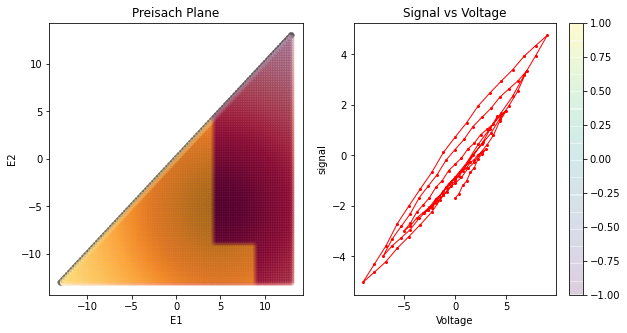

Analysis: 133 of 192


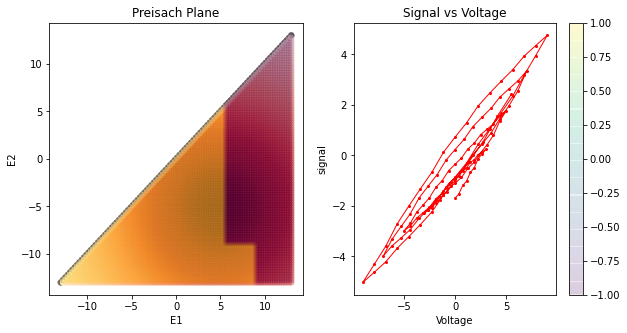

Analysis: 134 of 192


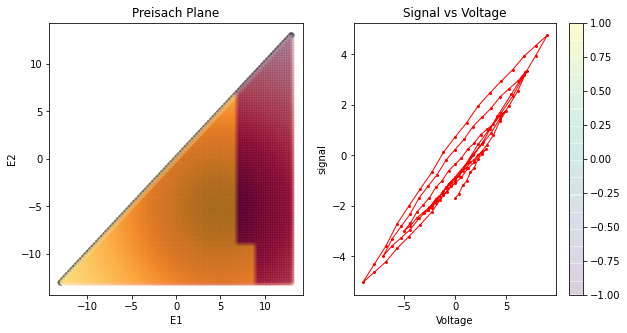

Analysis: 135 of 192


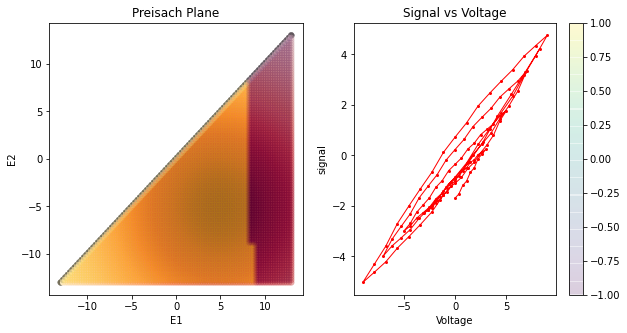

Analysis: 136 of 192


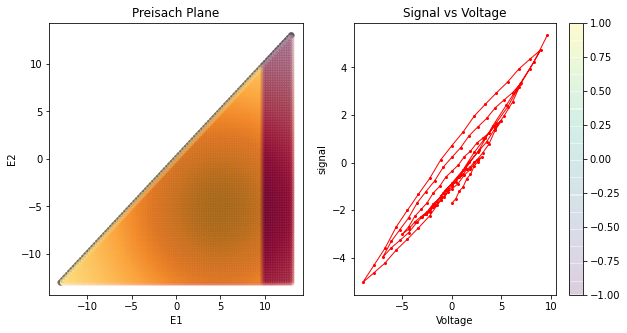

Analysis: 137 of 192


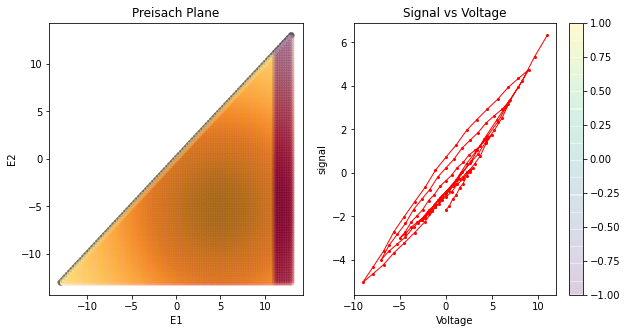

Analysis: 138 of 192


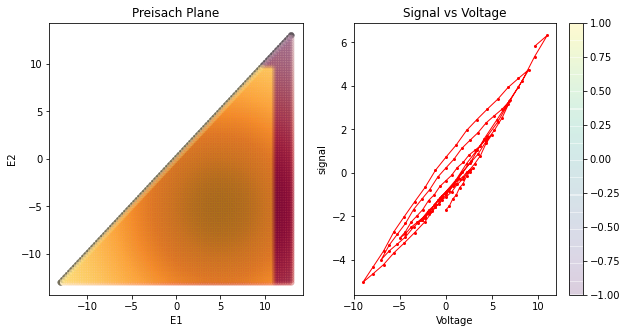

Analysis: 139 of 192


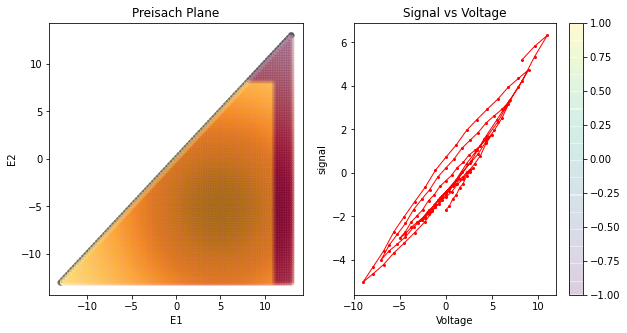

Analysis: 140 of 192


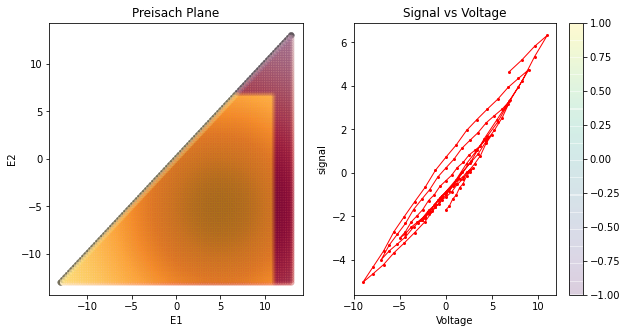

Analysis: 141 of 192


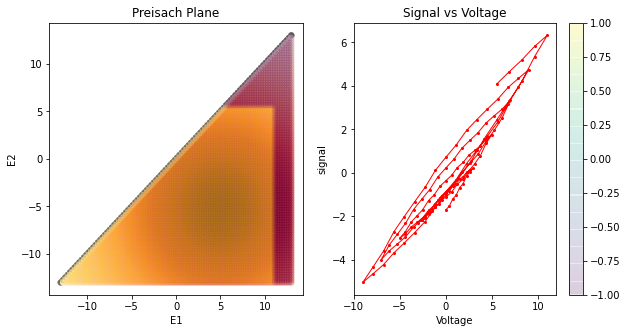

Analysis: 142 of 192


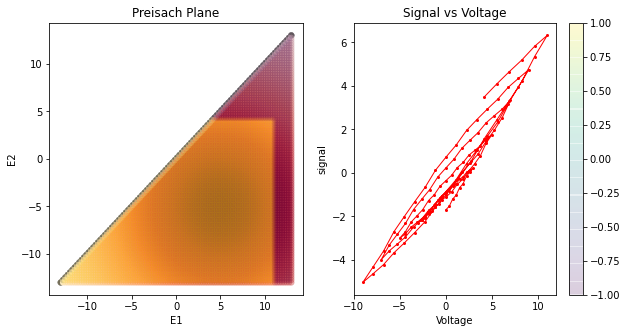

Analysis: 143 of 192


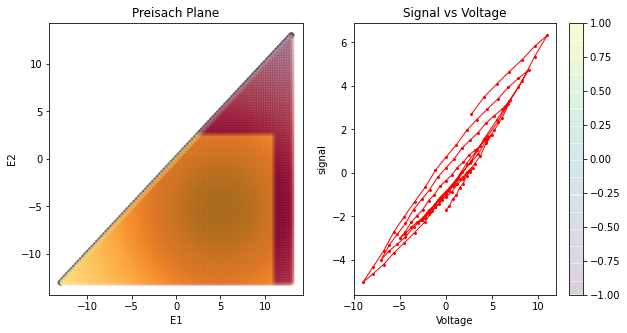

Analysis: 144 of 192


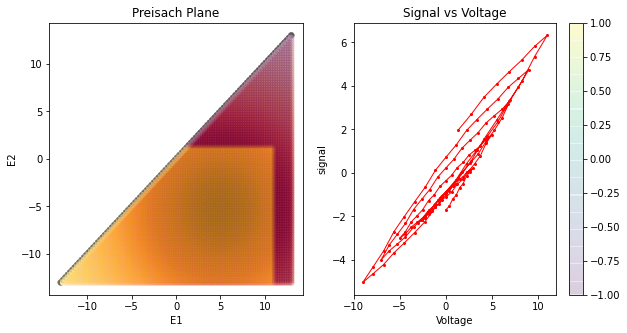

Analysis: 145 of 192


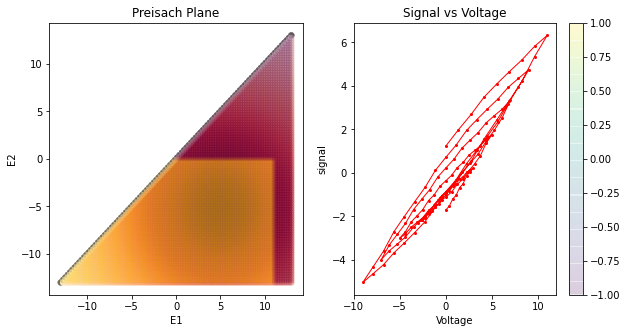

Analysis: 146 of 192


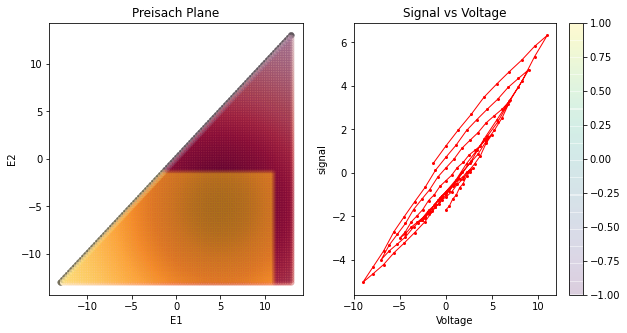

Analysis: 147 of 192


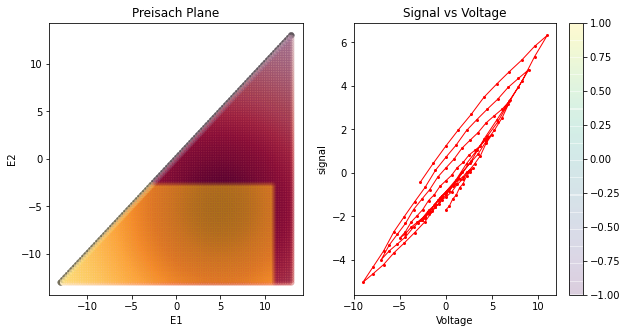

Analysis: 148 of 192


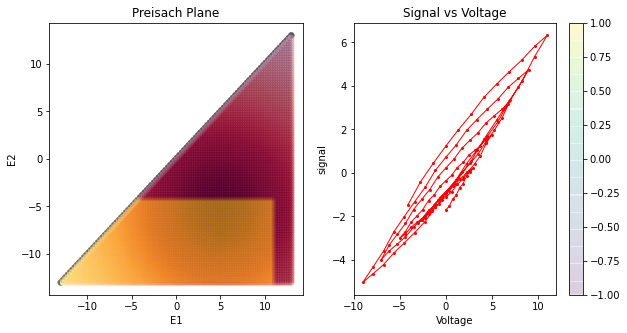

Analysis: 149 of 192


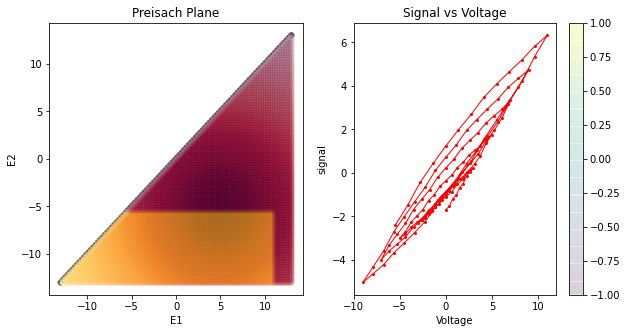

Analysis: 150 of 192


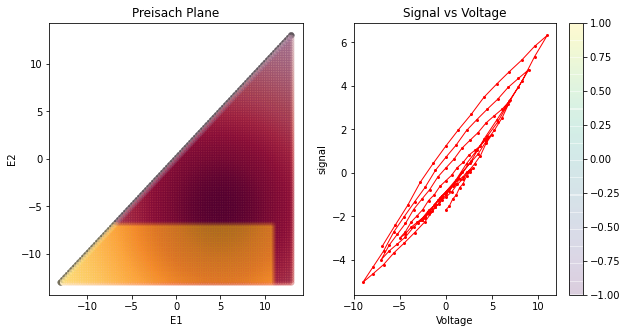

Analysis: 151 of 192


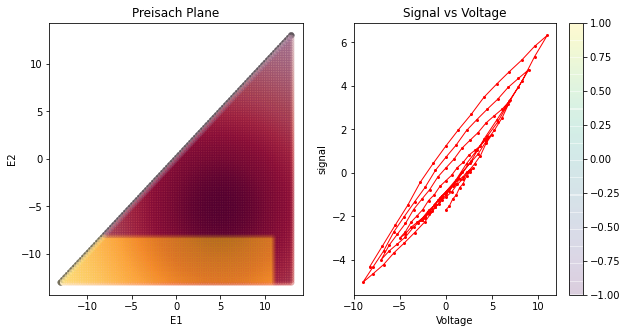

Analysis: 152 of 192


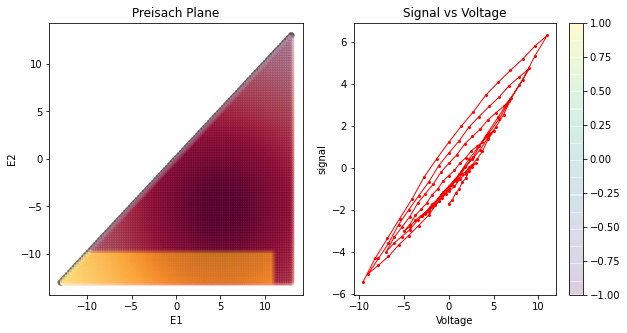

Analysis: 153 of 192


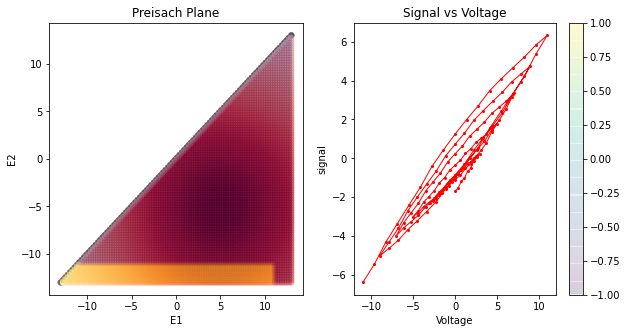

Analysis: 154 of 192


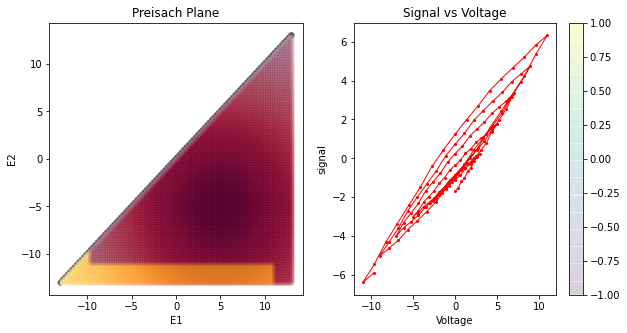

Analysis: 155 of 192


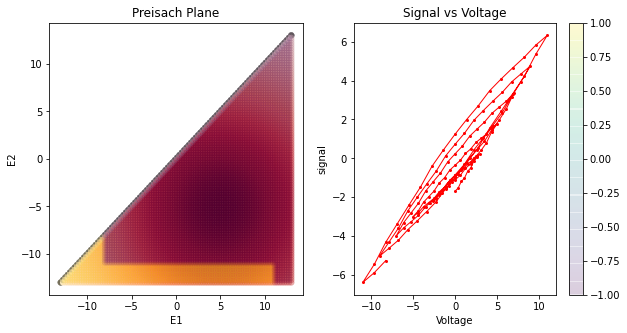

Analysis: 156 of 192


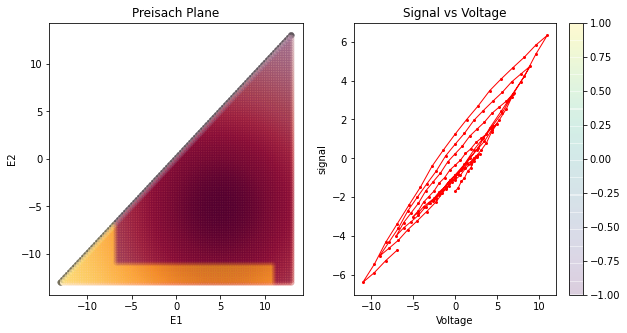

Analysis: 157 of 192


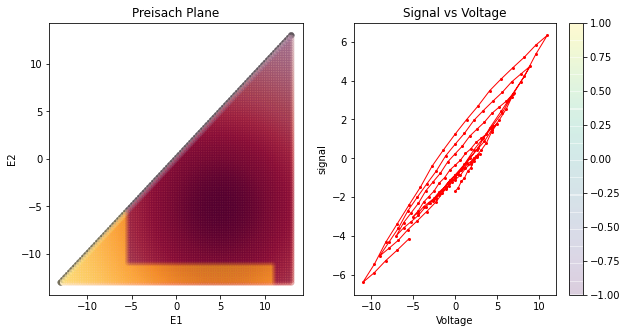

Analysis: 158 of 192


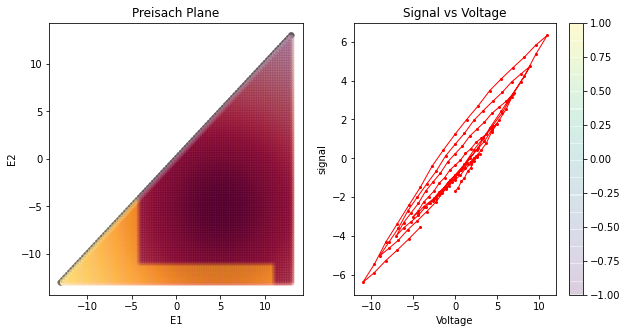

Analysis: 159 of 192


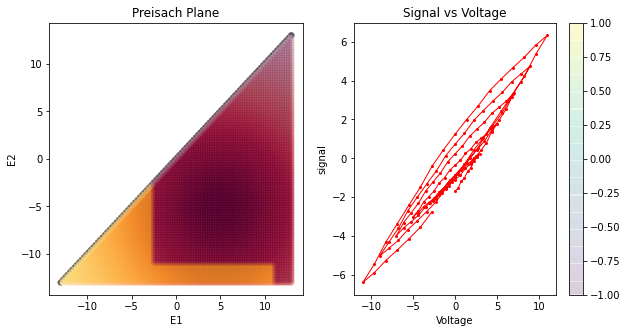

Analysis: 160 of 192


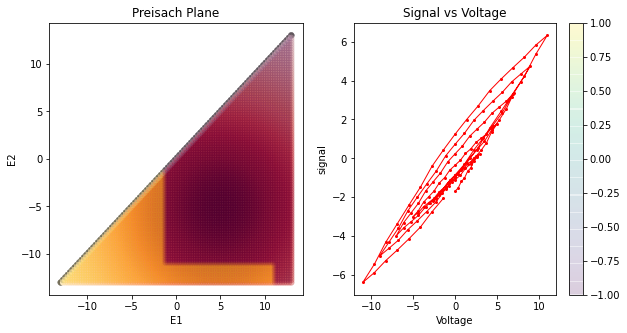

Analysis: 161 of 192


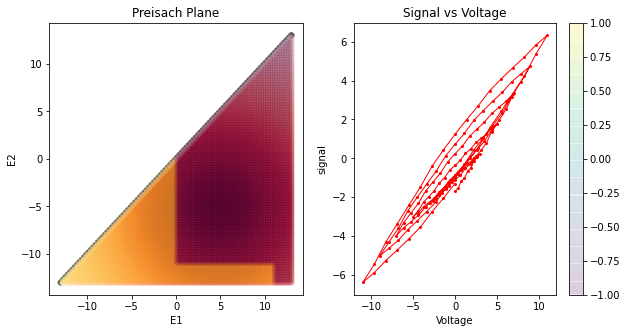

Analysis: 162 of 192


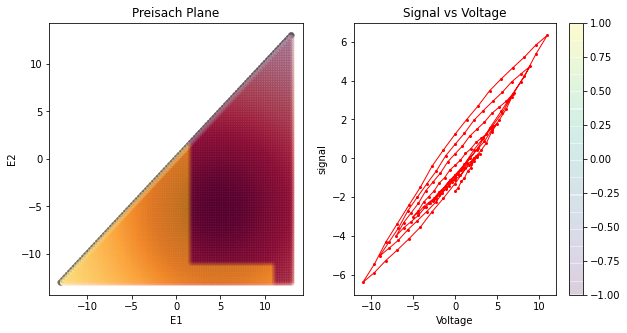

Analysis: 163 of 192


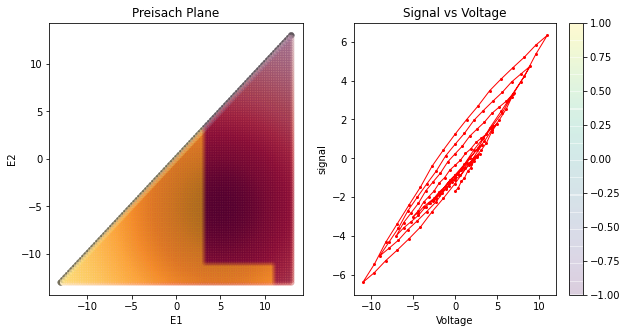

Analysis: 164 of 192


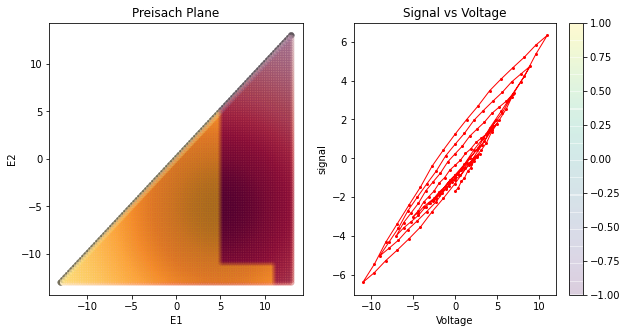

Analysis: 165 of 192


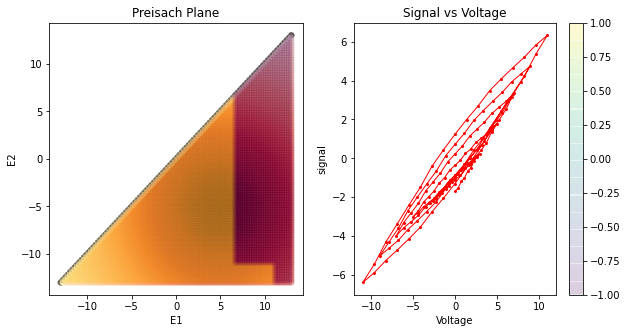

Analysis: 166 of 192


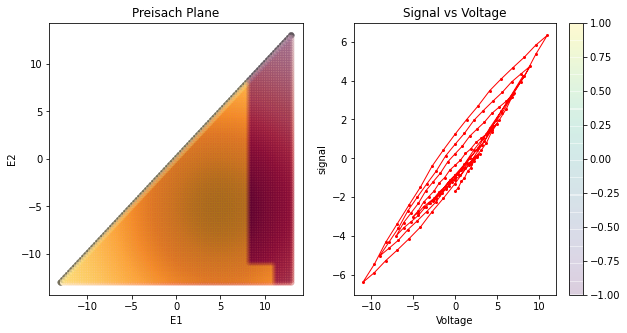

Analysis: 167 of 192


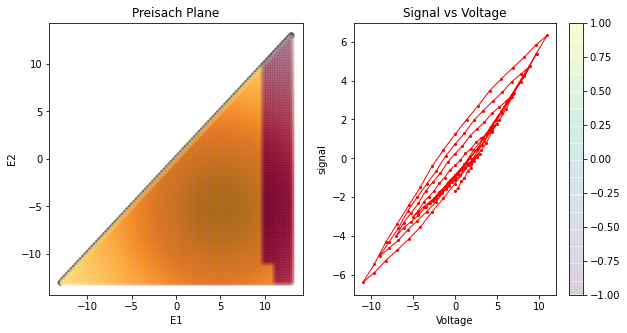

Analysis: 168 of 192


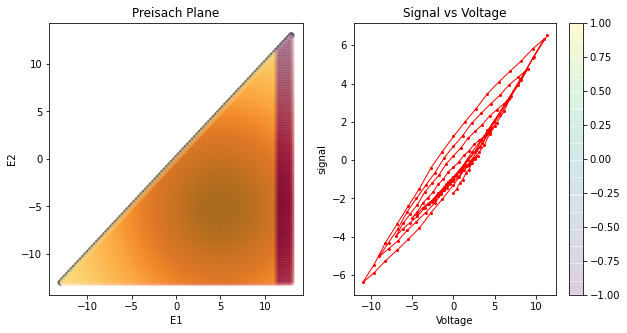

Analysis: 169 of 192


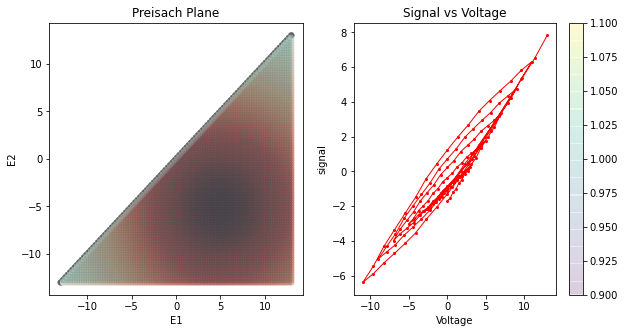

Analysis: 170 of 192


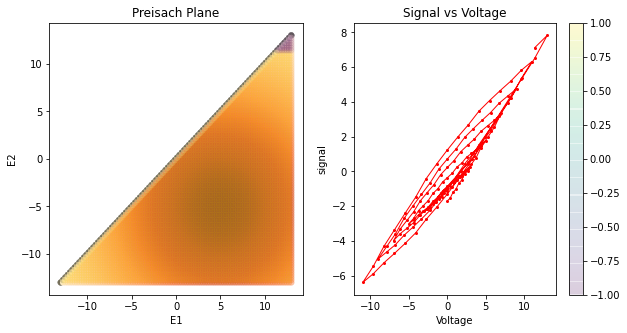

Analysis: 171 of 192


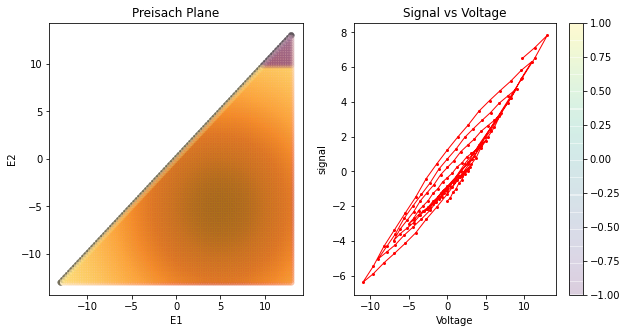

Analysis: 172 of 192


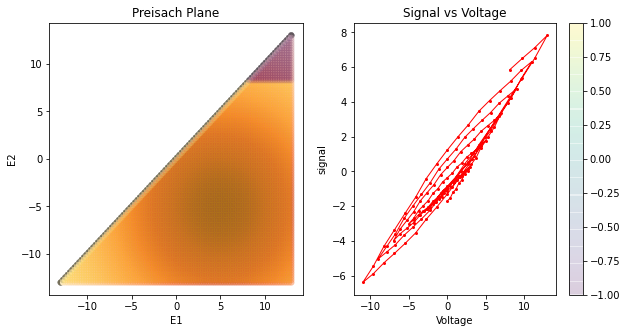

Analysis: 173 of 192


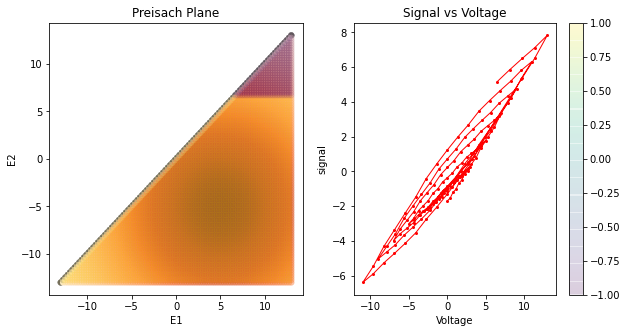

Analysis: 174 of 192


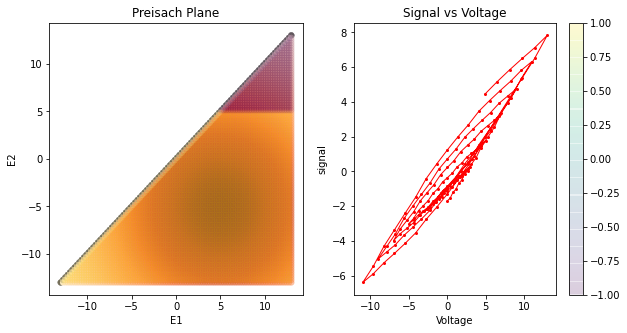

Analysis: 175 of 192


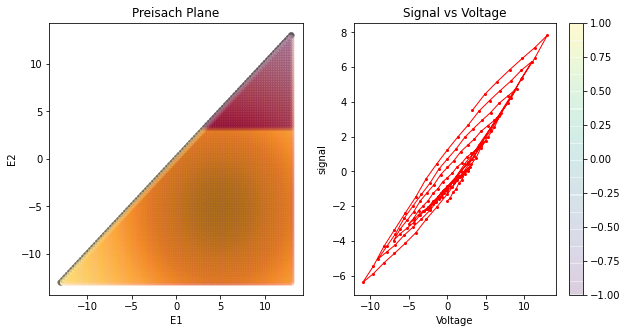

Analysis: 176 of 192


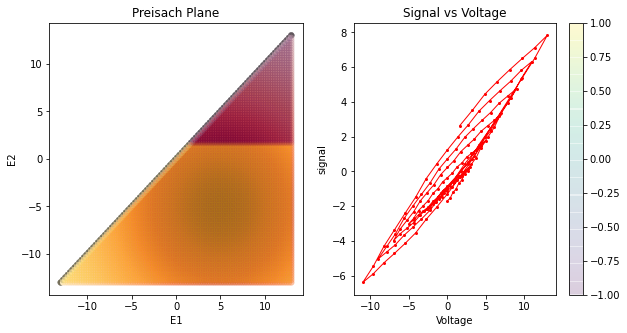

Analysis: 177 of 192


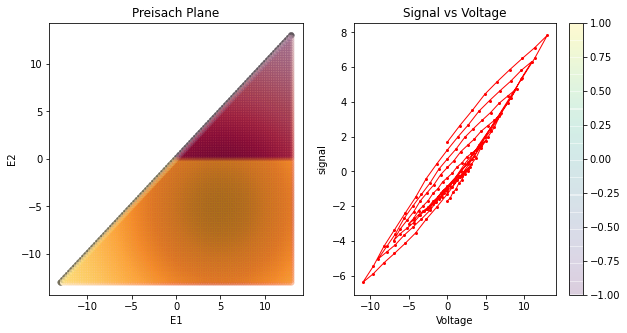

Analysis: 178 of 192


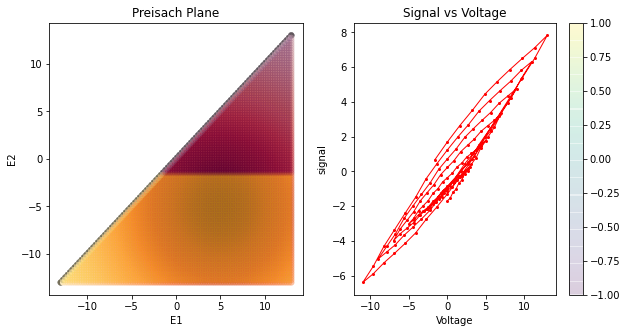

Analysis: 179 of 192


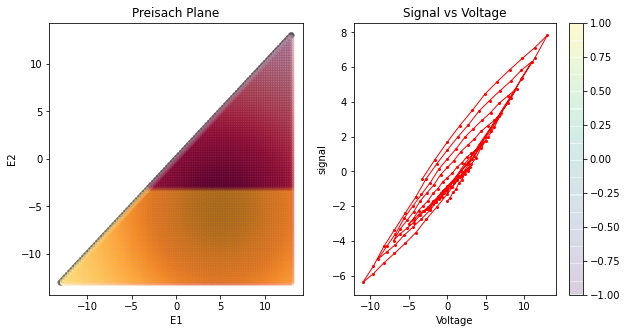

Analysis: 180 of 192


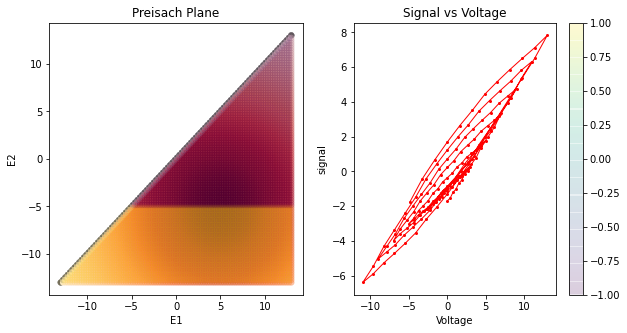

Analysis: 181 of 192


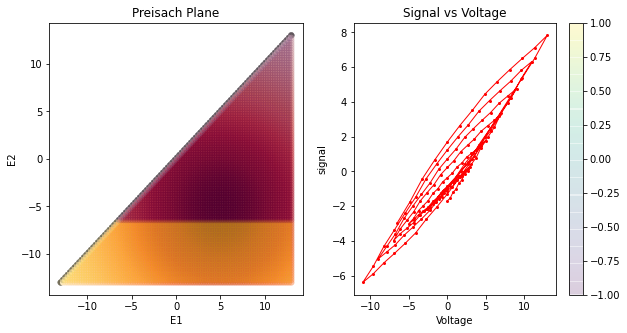

Analysis: 182 of 192


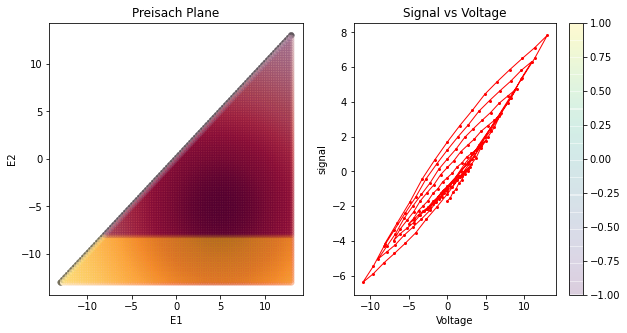

Analysis: 183 of 192


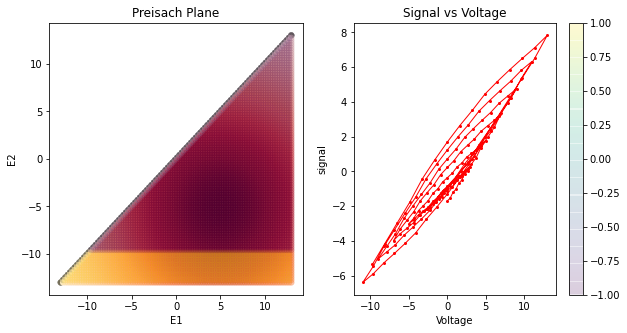

Analysis: 184 of 192


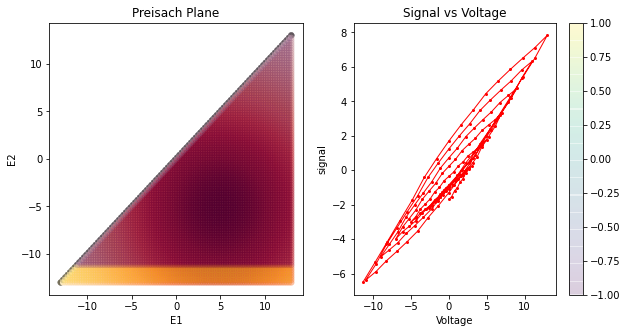

Analysis: 185 of 192


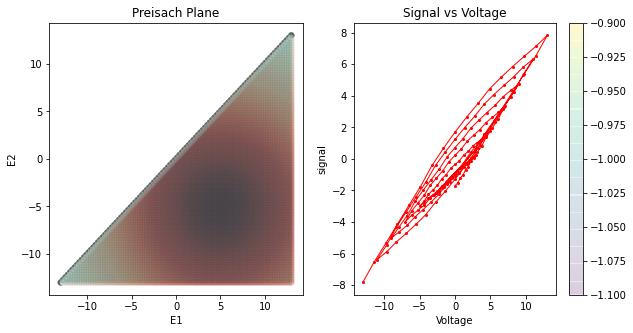

Analysis: 186 of 192


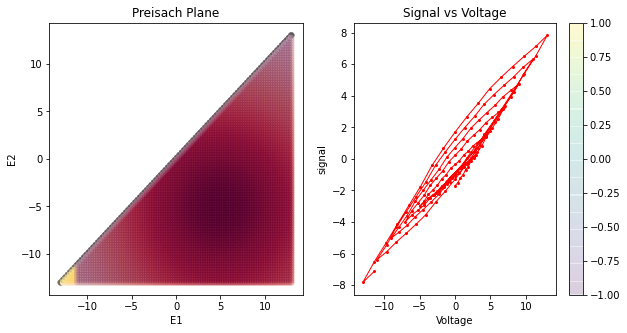

Analysis: 187 of 192


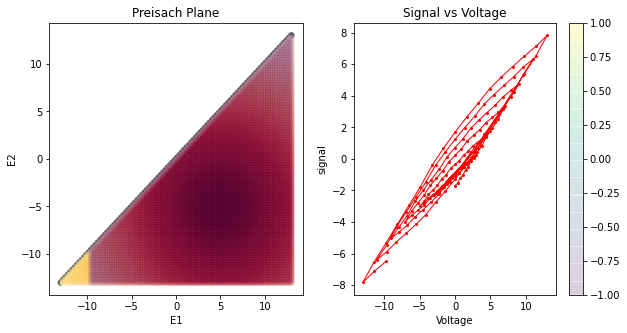

Analysis: 188 of 192


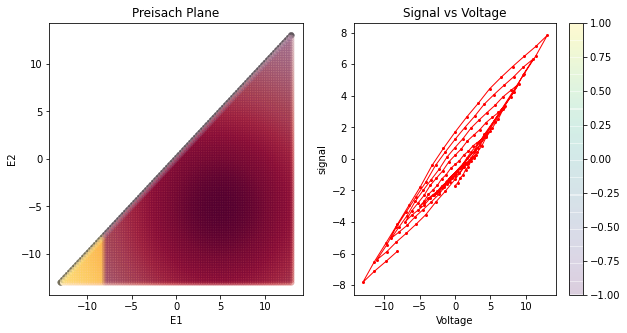

Analysis: 189 of 192


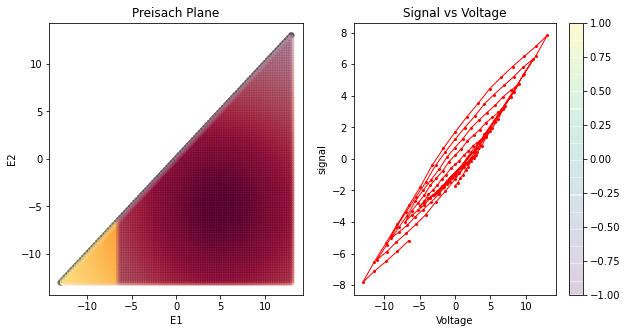

Analysis: 190 of 192


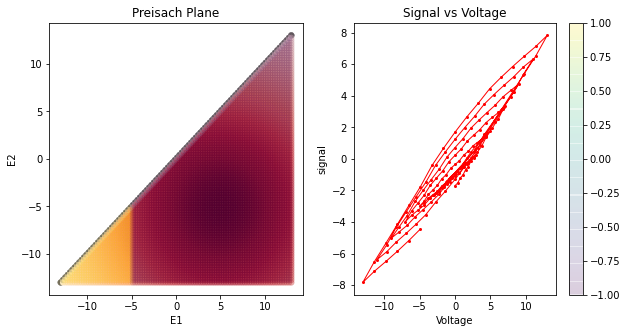

Analysis: 191 of 192


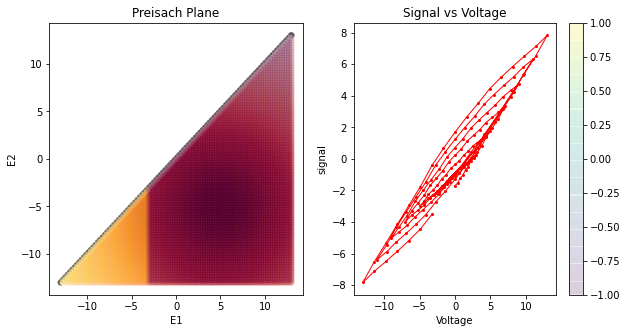

Analysis: 192 of 192


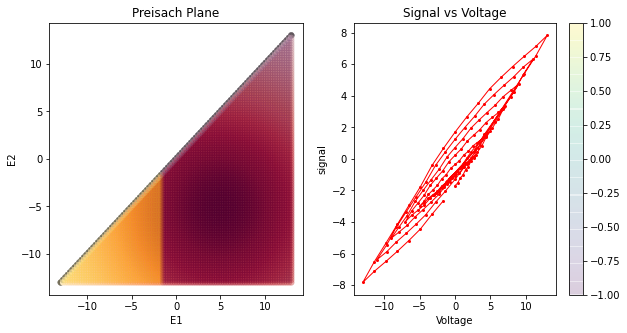

In [9]:
signal_total, S_full, P_density_full, phi_rev_full, phi_ir_full = PreisachModel_getSignal(E_Preisachplane, voltage_step, choice = "Vmin")

#Plotting signal vs Voltage- showing loops


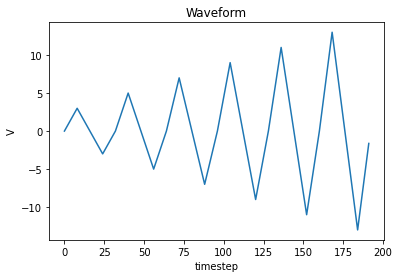

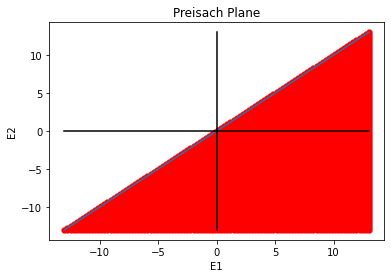

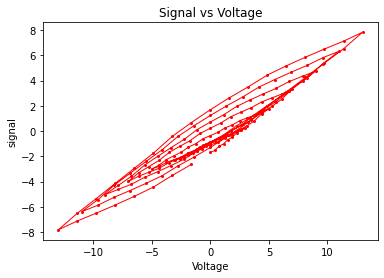

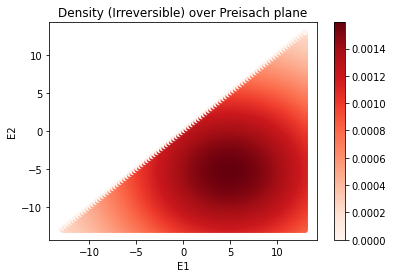

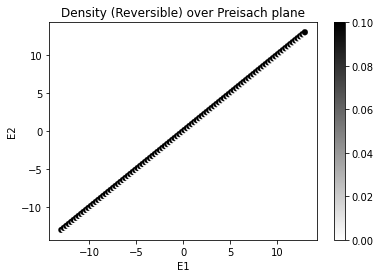

In [10]:
#Plot waveform
plt.plot(voltage_step)
plt.xlabel('timestep')
plt.ylabel('V')
plt.title('Waveform')
plt.show()

#Plot Preisach plane without defined state of hysterons
plt.plot([np.min(voltage_step), np.max(voltage_step)], [np.min(voltage_step), np.max(voltage_step)])
plt.plot([0, 0], [np.min(voltage_step), np.max(voltage_step)], 'k-')
plt.plot([np.min(voltage_step), np.max(voltage_step)], [0, 0], 'k-')
plt.scatter(E_Preisachplane[:,0], E_Preisachplane[:,1], c='red',linewidth=0.2)
plt.xlabel('E1')
plt.ylabel('E2')
plt.title('Preisach Plane')
plt.show()

#Plotting signal vs Voltage- loop diagram

plt.plot(voltage_step, signal_total, 'ro-', markersize=2, linewidth=1)
plt.xlabel('Voltage')
plt.ylabel('signal')
plt.title('Signal vs Voltage')
plt.show()

# Plot irreversible density (Gaussian) over Preisach plane
plt.scatter(E_Preisachplane[:,0], E_Preisachplane[:,1], c=phi_ir_full[:,0], cmap='Reds', linewidth=0.2)
plt.xlabel('E1')
plt.ylabel('E2')
plt.title('Density (Irreversible) over Preisach plane')
plt.colorbar()
plt.show()

# Plot reversible density (delta function) over Preisach plane
plt.scatter(E_Preisachplane[:,0], E_Preisachplane[:,1], c=phi_rev_full[:,0], cmap='binary', linewidth=0.2)
plt.xlabel('E1')
plt.ylabel('E2')
plt.title('Density (Reversible) over Preisach plane')
plt.colorbar()
plt.show()

#Try yourself

- Now lets assume we dont know how to start the sweep so, choice = "random" as this is most interesting one


In [ ]:
signal_total, S_full, P_density_full, phi_rev_full, phi_ir_full = PreisachModel_getSignal(E_Preisachplane, voltage_step, choice = "random")